# Notebook 1: Shot Scale Classification Using Pose Estimation

This notebook uses pose estimation as a means to perform shot scale classification. [Cao et al. (2017)'s](https://github.com/ZheC/Realtime_Multi-Person_Pose_Estimation) pre-trained model was used for pose estimation and obtain the keypoints of body parts. From there the keypoints were used to classify the shot scale of the image.

The classification logic was initially tuned on a dataset of 86 thumbnails from 10 videos and then tested on a separate dataset of 95 thumbnails from 5 videos. These datasets were manually labelled by a single human coder.

---

Further links:

[Cao et al (2017)'s Colab Notebook](https://colab.research.google.com/drive/1yM--K03ZvSiEi8Pudj5Vj_pWiZ6GI__y)).

Prepared by Mike Chow

michael.chow@student.uva.nl

## Initialise pose estimation model and dependencies

In [ ]:
!pip -q install Cython scikit-image pandas zmq h5py opencv-python configobj

In [ ]:
# Install pose estimation model and pre-requisites
!git clone https://github.com/kevinlin311tw/keras-openpose-reproduce.git
!mv keras-openpose-reproduce/* ./    &&    mkdir model/keras
!cd model   && sh get_keras_model.sh
!pip3 -q install Cython scikit-image pandas zmq h5py opencv-python configobj
# While installing locally, there is a need to manually insert the configobj.py file into the library map
# I also needed to manually download the pretrained weights and map it
# No such issues on Google Colab

fatal: destination path 'keras-openpose-reproduce' already exists and is not an empty directory.
zsh:1: no matches found: keras-openpose-reproduce/*
get_keras_model.sh: line 3: wget: command not found


In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Activation, Lambda
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Concatenate
from config_reader import config_reader
import scipy
import math
import util
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import pandas as pd
from numpy import ma
import os
import re
from scipy.ndimage import gaussian_filter

In [ ]:
# Defining the model
def relu(x):
    return Activation('relu')(x)

def conv(x, nf, ks, name):
    x1 = Conv2D(nf, (ks, ks), padding='same', name=name)(x)
    return x1

def pooling(x, ks, st, name):
    x = MaxPooling2D((ks, ks), strides=(st, st), name=name)(x)
    return x

def vgg_block(x):

    # Block 1
    x = conv(x, 64, 3, "conv1_1")
    x = relu(x)
    x = conv(x, 64, 3, "conv1_2")
    x = relu(x)
    x = pooling(x, 2, 2, "pool1_1")

    # Block 2
    x = conv(x, 128, 3, "conv2_1")
    x = relu(x)
    x = conv(x, 128, 3, "conv2_2")
    x = relu(x)
    x = pooling(x, 2, 2, "pool2_1")

    # Block 3
    x = conv(x, 256, 3, "conv3_1")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_2")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_3")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_4")
    x = relu(x)
    x = pooling(x, 2, 2, "pool3_1")

    # Block 4
    x = conv(x, 512, 3, "conv4_1")
    x = relu(x)
    x = conv(x, 512, 3, "conv4_2")
    x = relu(x)

    # Additional non vgg layers
    x = conv(x, 256, 3, "conv4_3_CPM")
    x = relu(x)
    x = conv(x, 128, 3, "conv4_4_CPM")
    x = relu(x)

    return x

def stage1_block(x, num_p, branch):

    # Block 1
    x = conv(x, 128, 3, "conv5_1_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 128, 3, "conv5_2_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 128, 3, "conv5_3_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 512, 1, "conv5_4_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, num_p, 1, "conv5_5_CPM_L%d" % branch)

    return x

def stageT_block(x, num_p, stage, branch):

    # Block 1
    x = conv(x, 128, 7, "Mconv1_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv2_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv3_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv4_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv5_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 1, "Mconv6_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, num_p, 1, "Mconv7_stage%d_L%d" % (stage, branch))

    return x

In [ ]:
weights_path = "/model/keras/model.h5"  # Please update the path as needed
# orginal weights converted from caffe
# Adjust path as needed when manually loading the model weights
#weights_path = "training/weights.best.h5" # weights trained from scratch

input_shape = (None,None,3)

img_input = Input(shape=input_shape)

stages = 6
np_branch1 = 38
np_branch2 = 19

img_normalized = Lambda(lambda x: x / 256 - 0.5)(img_input)  # [-0.5, 0.5]

# VGG
stage0_out = vgg_block(img_normalized)

# stage 1
stage1_branch1_out = stage1_block(stage0_out, np_branch1, 1)
stage1_branch2_out = stage1_block(stage0_out, np_branch2, 2)
x = Concatenate()([stage1_branch1_out, stage1_branch2_out, stage0_out])

# stage t >= 2
for sn in range(2, stages + 1):
    stageT_branch1_out = stageT_block(x, np_branch1, sn, 1)
    stageT_branch2_out = stageT_block(x, np_branch2, sn, 2)
    if (sn < stages):
        x = Concatenate()([stageT_branch1_out, stageT_branch2_out, stage0_out])

model = Model(img_input, [stageT_branch1_out, stageT_branch2_out])
model.load_weights(weights_path)

## Define key functions
Helper functions to aid in creating pose and classifying shot scale
- ``` read_rgb(image_path) ``` - Reads image path as an RGB array using OpenCV
- ``` create_pose(image) ``` - Identifies body keypoints using pose estimation model; Returns plot with mapped keypoints and a dataframe with individuals and their body keypoints detected in the image
- ``` class_shot_scale(image, df_people) ``` - Takes an image and the people/body keypoints detected in the image for shot scale classification
- ``` get_shot_scale(image_path) ``` - Combines the earlier helper functions into one neat function that also displays the pose mapping

In [ ]:
def read_rgb(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [ ]:
# Function to retrieve pose
from IPython.display import clear_output

def create_pose(image):

    oriImg = image.copy()

    # Establish parameters
    param, model_params = config_reader()
    multiplier = [x * model_params['boxsize'] / oriImg.shape[0] for x in param['scale_search']]

    # Run model on the same image at different scales
    # Aggregate the resulting heatmaps of body part locations (keypoints), and part affinities (PAF)

    # Instantiate averages
    heatmap_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 19))
    paf_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 38))

    for m in range(len(multiplier)):
        scale = multiplier[m]
        imageToTest = cv2.resize(oriImg, (0,0), fx=scale, fy=scale, interpolation=cv2.INTER_CUBIC)
        imageToTest_padded, pad = util.padRightDownCorner(imageToTest, model_params['stride'], model_params['padValue'])
        # axarr[m].imshow(imageToTest_padded)  # Hiding in between calculations
        # axarr[m].set_title('Input image: scale %d' % m)

        input_img = np.transpose(np.float32(imageToTest_padded[:,:,:,np.newaxis]), (3,0,1,2)) # required shape (1, width, height, channels)

        output_blobs = model.predict(input_img)

        # extract outputs, resize, and remove padding
        heatmap = np.squeeze(output_blobs[1]) # output 1 is heatmaps
        heatmap = cv2.resize(heatmap, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
        heatmap = heatmap[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
        heatmap = cv2.resize(heatmap, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

        paf = np.squeeze(output_blobs[0]) # output 0 is PAFs
        paf = cv2.resize(paf, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
        paf = paf[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
        paf = cv2.resize(paf, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

        heatmap_avg = heatmap_avg + heatmap / len(multiplier)
        paf_avg = paf_avg + paf / len(multiplier)

    # Detect body parts and show them based on heatmaps
    all_peaks = []
    peak_counter = 0

    for part in range(19-1):
        map_ori = heatmap_avg[:,:,part]
        map = gaussian_filter(map_ori, sigma=3)

        map_left = np.zeros(map.shape)
        map_left[1:,:] = map[:-1,:]
        map_right = np.zeros(map.shape)
        map_right[:-1,:] = map[1:,:]
        map_up = np.zeros(map.shape)
        map_up[:,1:] = map[:,:-1]
        map_down = np.zeros(map.shape)
        map_down[:,:-1] = map[:,1:]

        peaks_binary = np.logical_and.reduce((map>=map_left, map>=map_right, map>=map_up, map>=map_down, map > param['thre1']))
        peaks = list(zip(np.nonzero(peaks_binary)[1], np.nonzero(peaks_binary)[0])) # note reverse
        peaks_with_score = [x + (map_ori[x[1],x[0]],) for x in peaks]
        id = range(peak_counter, peak_counter + len(peaks))
        peaks_with_score_and_id = [peaks_with_score[i] + (id[i],) for i in range(len(id))]

        all_peaks.append(peaks_with_score_and_id)
        peak_counter += len(peaks)

    # Add dots
    canvas = oriImg

    # Assign colours
    colors = [[255, 0, 0], [255, 85, 0], [255, 170, 0], [255, 255, 0], [170, 255, 0], [85, 255, 0], [0, 255, 0], \
              [0, 255, 85], [0, 255, 170], [0, 255, 255], [0, 170, 255], [0, 85, 255], [0, 0, 255], [85, 0, 255], \
              [170, 0, 255], [255, 0, 255], [255, 0, 170], [255, 0, 85]]
    cmap = matplotlib.colormaps.get_cmap('hsv')

    for i in range(18):
        rgba = np.array(cmap(1 - i/18. - 1./36))
        rgba[0:3] *= 255
        for j in range(len(all_peaks[i])):
            cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)


    # Link Body parts
    # find connection in the specified sequence, center 29 is in the position 15
    limbSeq = [[2,3], [2,6], [3,4], [4,5], [6,7], [7,8], [2,9], [9,10], \
              [10,11], [2,12], [12,13], [13,14], [2,1], [1,15], [15,17], \
              [1,16], [16,18], [3,17], [6,18]]
    # the middle joints heatmap correpondence
    mapIdx = [[31,32], [39,40], [33,34], [35,36], [41,42], [43,44], [19,20], [21,22], \
              [23,24], [25,26], [27,28], [29,30], [47,48], [49,50], [53,54], [51,52], \
              [55,56], [37,38], [45,46]]

    connection_all = []
    special_k = []
    mid_num = 10

    for k in range(len(mapIdx)):
        score_mid = paf_avg[:,:,[x-19 for x in mapIdx[k]]]
        candA = all_peaks[limbSeq[k][0]-1]
        candB = all_peaks[limbSeq[k][1]-1]
        nA = len(candA)
        nB = len(candB)
        indexA, indexB = limbSeq[k]
        if(nA != 0 and nB != 0):
            connection_candidate = []
            for i in range(nA):
                for j in range(nB):
                    vec = np.subtract(candB[j][:2], candA[i][:2])
                    norm = math.sqrt(vec[0]*vec[0] + vec[1]*vec[1])
                    # failure case when 2 body parts overlaps
                    if norm == 0:
                        continue
                    vec = np.divide(vec, norm)

                    startend = list(zip(np.linspace(candA[i][0], candB[j][0], num=mid_num), \
                                  np.linspace(candA[i][1], candB[j][1], num=mid_num)))

                    vec_x = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 0] \
                                      for I in range(len(startend))])
                    vec_y = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 1] \
                                      for I in range(len(startend))])

                    score_midpts = np.multiply(vec_x, vec[0]) + np.multiply(vec_y, vec[1])
                    score_with_dist_prior = sum(score_midpts)/len(score_midpts) + min(0.5*oriImg.shape[0]/norm-1, 0)
                    criterion1 = len(np.nonzero(score_midpts > param['thre2'])[0]) > 0.8 * len(score_midpts)
                    criterion2 = score_with_dist_prior > 0
                    if criterion1 and criterion2:
                        connection_candidate.append([i, j, score_with_dist_prior, score_with_dist_prior+candA[i][2]+candB[j][2]])

            connection_candidate = sorted(connection_candidate, key=lambda x: x[2], reverse=True)
            connection = np.zeros((0,5))
            for c in range(len(connection_candidate)):
                i,j,s = connection_candidate[c][0:3]
                if(i not in connection[:,3] and j not in connection[:,4]):
                    connection = np.vstack([connection, [candA[i][3], candB[j][3], s, i, j]])
                    if(len(connection) >= min(nA, nB)):
                        break

            connection_all.append(connection)
        else:
            special_k.append(k)
            connection_all.append([])

    # last number in each row is the total parts number of that person
    # the second last number in each row is the score of the overall configuration
    subset = -1 * np.ones((0, 20))
    candidate = np.array([item for sublist in all_peaks for item in sublist])

    for k in range(len(mapIdx)):
        if k not in special_k:
            partAs = connection_all[k][:,0]
            partBs = connection_all[k][:,1]
            indexA, indexB = np.array(limbSeq[k]) - 1

            for i in range(len(connection_all[k])): #= 1:size(temp,1)
                found = 0
                subset_idx = [-1, -1]
                for j in range(len(subset)): #1:size(subset,1):
                    if subset[j][indexA] == partAs[i] or subset[j][indexB] == partBs[i]:
                        subset_idx[found] = j
                        found += 1

                if found == 1:
                    j = subset_idx[0]
                    if(subset[j][indexB] != partBs[i]):
                        subset[j][indexB] = partBs[i]
                        subset[j][-1] += 1
                        subset[j][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]
                elif found == 2: # if found 2 and disjoint, merge them
                    j1, j2 = subset_idx

                    membership = ((subset[j1]>=0).astype(int) + (subset[j2]>=0).astype(int))[:-2]
                    if len(np.nonzero(membership == 2)[0]) == 0: #merge
                        subset[j1][:-2] += (subset[j2][:-2] + 1)
                        subset[j1][-2:] += subset[j2][-2:]
                        subset[j1][-2] += connection_all[k][i][2]
                        subset = np.delete(subset, j2, 0)
                    else: # as like found == 1
                        subset[j1][indexB] = partBs[i]
                        subset[j1][-1] += 1
                        subset[j1][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]

                # if find no partA in the subset, create a new subset
                elif not found and k < 17:
                    row = -1 * np.ones(20)
                    row[indexA] = partAs[i]
                    row[indexB] = partBs[i]
                    row[-1] = 2
                    row[-2] = sum(candidate[connection_all[k][i,:2].astype(int), 2]) + connection_all[k][i][2]
                    subset = np.vstack([subset, row])

    # delete some rows of subset which has few parts occur
    deleteIdx = [];
    for i in range(len(subset)):
        if subset[i][-1] < 4 or subset[i][-2]/subset[i][-1] < 0.4:
            deleteIdx.append(i)
    subset = np.delete(subset, deleteIdx, axis=0)

    # clear_output()  # Prevent progress bar from showing; But will not load graphs on loop


    # Display pose
    stickwidth = 4

    for i in range(17):
        for n in range(len(subset)):
            index = subset[n][np.array(limbSeq[i])-1]  # Retrieve indice of two body parts
            if -1 in index:  # Skips drawing if necessary part is missing
                continue
            # Draw limbs
            cur_canvas = canvas.copy()
            Y = candidate[index.astype(int), 0]
            X = candidate[index.astype(int), 1]
            mX = np.mean(X)
            mY = np.mean(Y)
            length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
            angle = math.degrees(math.atan2(X[0] - X[1], Y[0] - Y[1]))
            polygon = cv2.ellipse2Poly((int(mY),int(mX)), (int(length/2), stickwidth), int(angle), 0, 360, 1)
            cv2.fillConvexPoly(cur_canvas, polygon, colors[i])
            canvas = cv2.addWeighted(canvas, 0.4, cur_canvas, 0.6, 0)


    # plt.imshow(canvas) # Hidden to add shot scale classification as a title label later
    # plt.axis('off')

    # Remap subset and candidate into a dataframe of people found
    list_person = []
    for person_index in range(len(subset)):
        person_dict = {'person_id' : person_index }
        body_part_names = ['nose', 'neck', 'Rsho', 'Relb', 'Rwri', 'Lsho', 'Lelb', 'Lwri', 'Rhip', 'Rkne', 'Rank', 'Lhip', 'Lkne', 'Lank', 'Leye', 'Reye', 'Lear', 'Rear']
        # Iterate through each body part
        body_part_counter = 0
        for body_part_index in range(18):
            body_part_name = body_part_names[body_part_index]
            keypoint_id = subset[person_index][body_part_index]  # Obtain keypoint_id

            if keypoint_id != -1: # Retrieve keypoint data in 'candidate' using id
                keypoint_data = candidate[int(keypoint_id)]
                x_coord, y_coord, _score, _ = keypoint_data

                body_part_data = (x_coord, y_coord, int(keypoint_id))
                person_dict[body_part_name] = body_part_data
                body_part_counter += 1
            else: # key point is empty
                person_dict[body_part_name] = None
        person_dict['num_body_parts'] = body_part_counter

        list_person.append(person_dict)
    df_people = pd.DataFrame(list_person)

    return canvas, df_people # Return canvas and df_people for further additions later

The model creates key points as such, aligned to this list of body parts where the index corresponds to the number in the image.

`body_part_names = ['nose', 'neck', 'Rsho', 'Relb', 'Rwri', 'Lsho', 'Lelb', 'Lwri', 'Rhip', 'Rkne', 'Rank', 'Lhip', 'Lkne', 'Lank', 'Leye', 'Reye', 'Lear', 'Rear']`

In [ ]:
def class_shot_scale(image, df_people):
    '''
    Classification logic
    Input:
    image = original image in np array
    df_people = dataframe containing people and their body keypoints
    '''
    # Obtain image dimensions
    img_height = image.shape[0]
    img_width = image.shape[1]

    if len(df_people) == 0: # No people detected
        return 'Empty' # Therefore Empty shot

    # Handle multi-person cases by selecting the person with the largest vertical space (Presumably the most prominent)
    if len(df_people) > 1:
        list_heights = []
        for i, person in df_people.iterrows():
            # Obtain y-coordinates of detected keypoints
            y_coordinates = []
            body_part_names = ['nose', 'neck', 'Rsho', 'Relb', 'Rwri', 'Lsho', 'Lelb', 'Lwri', 'Rhip', 'Rkne', 'Rank', 'Lhip', 'Lkne', 'Lank', 'Leye', 'Reye', 'Lear', 'Rear']
            for body_part_name in body_part_names:
               if body_part_name in person and person[body_part_name] is not None:
                        keypoint_data = person[body_part_name]
                        y_coordinates.append(keypoint_data[1]) # Append the y-coordinate
            if y_coordinates:

                min_y = min(y_coordinates)
                max_y = max(y_coordinates)
                # Calculate vertical height of figure
                body_height = abs(min_y - max_y)
                list_heights.append(body_height)
            else:
                list_heights.append(0)

        # Convert list to pandas Series for .idxmax()
        list_heights = pd.Series(list_heights, index=df_people.index)
        # Select row with maximum height
        df_people = df_people.loc[[list_heights.idxmax()]]


         # Select the row with the max num_body_parts

    # Obtain the body data
    body_data = df_people.iloc[0]
    if body_data['num_body_parts'] == 0:
        return 'Empty' # Failsafe check in case

    # Check for feet
    if body_data['Rank'] is not None or body_data['Lank'] is not None:
        feet = True
    else:
        feet = False

    # Check for face
    if body_data['Leye'] is not None or body_data['Reye'] is not None or \
        body_data['nose'] is not None or body_data['Lear'] is not None or \
        body_data['Rear'] is not None:
        face = True
    else:
        face = False

    # Obtain y-coordinates of detected keypoints
    y_coordinates = []
    # Iterate through columns of body_data
    for col in body_data.index:
        if col not in ['person_id', 'num_body_parts']: # Skip non-keypoint columns
            keypoint_data = body_data[col]
            if keypoint_data is not None:
                y_coordinates.append(keypoint_data[1]) # Append the y-coordinate

    if not y_coordinates: # If no keypoints were detected, return 'Empty'
        return 'Empty'

    # Obtain max and min y-coordinates of the pose
    min_y = min(y_coordinates)
    max_y = max(y_coordinates)

    # Check for Full shot (Full body detected)
      # Criteria:
      # - Face and feet detected
      # - Height of pose is more than half of the frame height
    if face and feet:
        body_height = abs(min_y - max_y)
        if body_height / img_height > 0.5: # Adjust threshold
            return 'Full shot'
        else:
            return 'Wide shot'
            # If less than half of frame height = Wide shot

    # Check for Medium Full Shot (Knees and up_
      # Criteria:
      # - Face detected
      # - Either knee detected

    elif (body_data['Rkne'] is not None or body_data['Lkne'] is not None) and face:
          return 'Medium full shot'

    # Check for Medium Shot (Waist and up)
      # Criteria:
      # - Face
      # - Either hips or elbows detected (Some may have shorter hips)

    elif face and (body_data['Rhip'] is not None or body_data['Lhip'] is not None or body_data['Relb'] is not None or body_data['Lelb'] is not None) and body_data['Rkne'] is None and body_data['Lkne'] is None and body_data['Rank'] is None:

            return 'Medium shot'

    # Check for Medium Close Up and Close Up
      # Combined criteria:
      # - Only shoulder and up
      # - Close up can be without
    elif face and body_data['Rhip'] is None and body_data['Lhip'] is None:
          if face and (body_data['Rsho'] is None and body_data['Lsho'] is None):
              return 'Close up'
              # If no shoulders detected (Face only), almost likely close up

          # If shoulder detected, need to pass a threshold check

          # Calculate vertical extent of upper body keypoints
          upper_body_y_coords = [kp[1] for kp in [body_data['nose'], body_data['neck'], body_data['Rsho'], body_data['Lsho']] if kp is not None]

          if upper_body_y_coords:
            upper_body_min_y = min(upper_body_y_coords)
            upper_body_max_y = max(upper_body_y_coords)
            upper_body_height = abs(upper_body_max_y - upper_body_min_y)

            # Proportion of frame threshold
            if upper_body_height / img_height < 0.6:
                  return 'Medium close up'
            else:
                  return 'Close up'
    else:
        # Default return if none of the above conditions are met
        return 'Medium close up'


In [ ]:
# Define full function that displays the plot and the keyframe

def get_shot_scale(image_path):
    # Read image as rgb
    image = read_rgb(image_path)
    # Detect pose, plot on canvas and return data
    canvas, df_people = (create_pose(read_rgb(image_path)))
    # Classify shot scale
    shot_scale = class_shot_scale(image, df_people)
    file_name = os.path.basename(image_path)

    plt.title(f'{file_name} \n Detected shot scale: {shot_scale}')
    plt.imshow(canvas)
    plt.axis('off')
    # plt.show()

    return shot_scale

## Test on one image

In [ ]:
test_image_path = ''

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 879ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


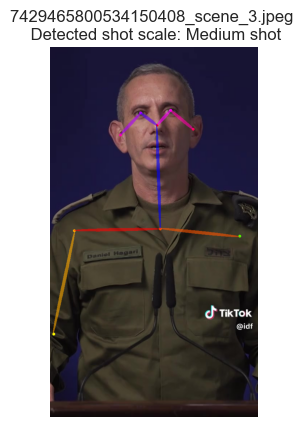

In [ ]:
shot_scale = get_shot_scale(test_image_path)

# Tuning classification logic
The classification logic was tuned on a dataset of 85 pre-labelled thumbnails

In [ ]:
df_scene = pd.read_csv('test_sample_scenes_2_merged.csv')

In [ ]:
df_scene

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,combat_presence_vlm_5b_motivation,spox_gender_m,shot_scale_m,selfie_m,location_m,combat_presence_m,spox_gender_c,shot_scale_c,location_c,combat_presence_c
0,7452697976306191623.mp4_scene_1,7452697976306191623,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,30.000,165,00:00:05.500,30.000,1,...,The backdrop shows an indoor setting with no v...,F,Medium close up,Selfie,Indoor,Non-combat,F,Selfie,Indoor,Non-combat
1,7452697976306191623.mp4_scene_2,7452697976306191623,dd01ff7a2a7ed42db656b1c7dbede342,165,00:00:05.500,30.000,427,00:00:14.233,30.000,2,...,The backdrop shows an indoor setting with wind...,F,Medium close up,Selfie,Indoor,Non-combat,F,Selfie,Indoor,Non-combat
2,7452697976306191623.mp4_scene_3,7452697976306191623,dd01ff7a2a7ed42db656b1c7dbede342,427,00:00:14.233,30.000,606,00:00:20.200,30.000,3,...,The backdrop shows an indoor setting with no v...,F,Medium close up,Selfie,Indoor,Non-combat,F,Selfie,Indoor,Non-combat
3,7452697976306191623.mp4_scene_4,7452697976306191623,dd01ff7a2a7ed42db656b1c7dbede342,606,00:00:20.200,30.000,772,00:00:25.733,30.000,4,...,The backdrop shows an indoor setting with no v...,F,Medium close up,Selfie,Indoor,Non-combat,F,Selfie,Indoor,Non-combat
4,7452697976306191623.mp4_scene_5,7452697976306191623,dd01ff7a2a7ed42db656b1c7dbede342,772,00:00:25.733,30.000,1025,00:00:34.167,30.000,5,...,The backdrop shows an indoor setting with no v...,F,Medium close up,Selfie,Indoor,Non-combat,F,Selfie,Indoor,Non-combat
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,7441620184583998728.mp4_scene_17,7441620184583998728,dd01ff7a2a7ed42db656b1c7dbede342,540,00:00:22.523,23.976,677,00:00:28.237,23.976,17,...,The backdrop shows a natural setting with tree...,M,Medium close up,Non-selfie,Outdoor,Non-combat,M,Medium close up,Outdoor,Non-combat
82,7441620184583998728.mp4_scene_18,7441620184583998728,dd01ff7a2a7ed42db656b1c7dbede342,677,00:00:28.237,23.976,701,00:00:29.238,23.976,18,...,"The backdrop appears to be a plain, light-colo...",M,Medium close up,Non-selfie,Outdoor,Non-combat,M,Medium close up,Outdoor,Non-combat
83,7441620184583998728.mp4_scene_19,7441620184583998728,dd01ff7a2a7ed42db656b1c7dbede342,701,00:00:29.238,23.976,732,00:00:30.531,23.976,19,...,The background shows a natural setting with tr...,M,Medium close up,Non-selfie,Outdoor,Non-combat,M,Medium close up,Outdoor,Non-combat
84,7441620184583998728.mp4_scene_20,7441620184583998728,dd01ff7a2a7ed42db656b1c7dbede342,732,00:00:30.531,23.976,775,00:00:32.324,23.976,20,...,The backdrop shows a natural setting with tree...,M,Medium close up,Non-selfie,Outdoor,Non-combat,M,Medium close up,Outdoor,Non-combat


In [ ]:
frames_folder = '01b_test_sample_2'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


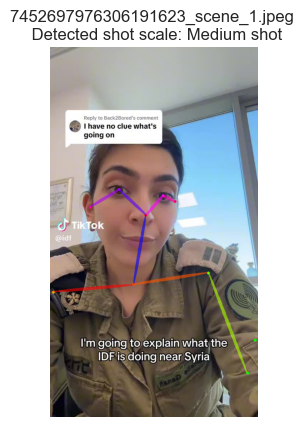

Scene: 7452697976306191623.mp4_scene_1 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


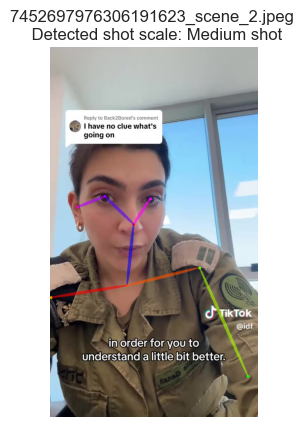

Scene: 7452697976306191623.mp4_scene_2 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


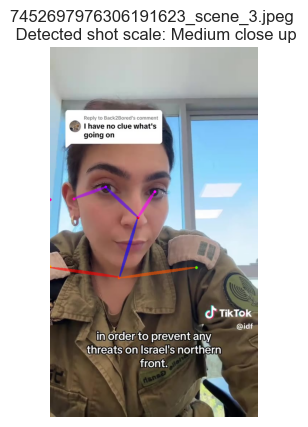

Scene: 7452697976306191623.mp4_scene_3 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


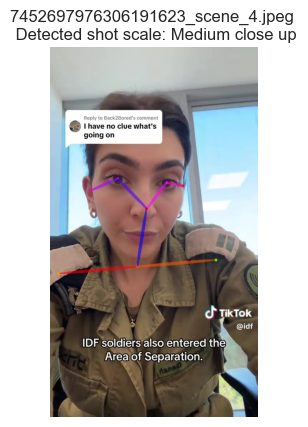

Scene: 7452697976306191623.mp4_scene_4 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


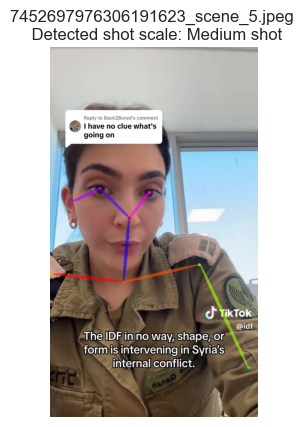

Scene: 7452697976306191623.mp4_scene_5 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


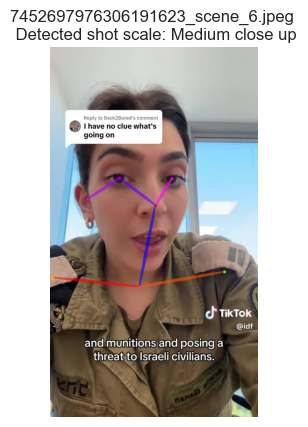

Scene: 7452697976306191623.mp4_scene_6 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


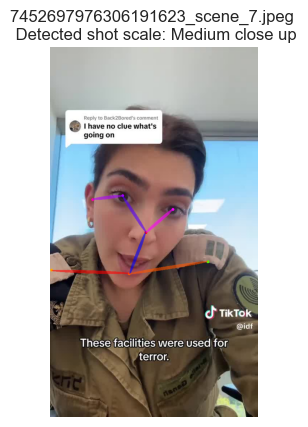

Scene: 7452697976306191623.mp4_scene_7 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


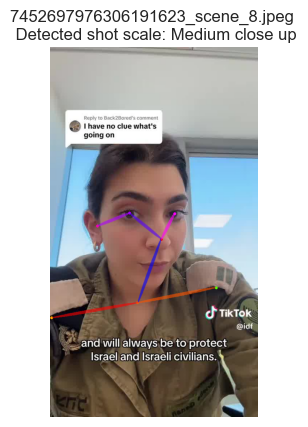

Scene: 7452697976306191623.mp4_scene_8 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 795ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


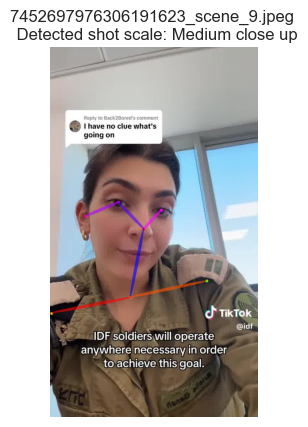

Scene: 7452697976306191623.mp4_scene_9 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


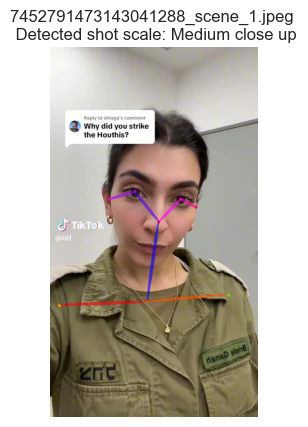

Scene: 7452791473143041288.mp4_scene_1 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


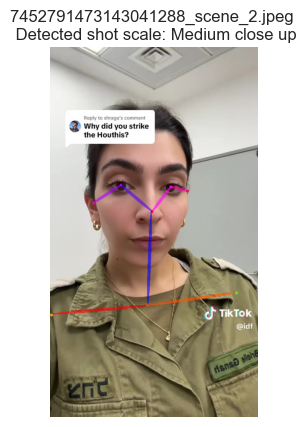

Scene: 7452791473143041288.mp4_scene_2 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


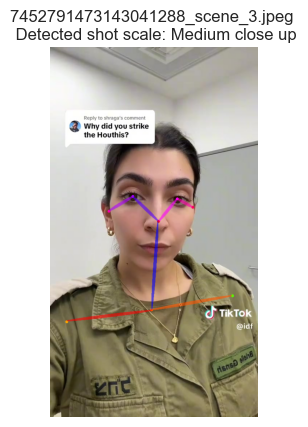

Scene: 7452791473143041288.mp4_scene_3 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


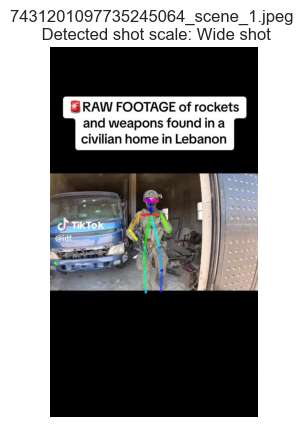

Scene: 7431201097735245064.mp4_scene_1 - Original: Full shot - Classified: Wide shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


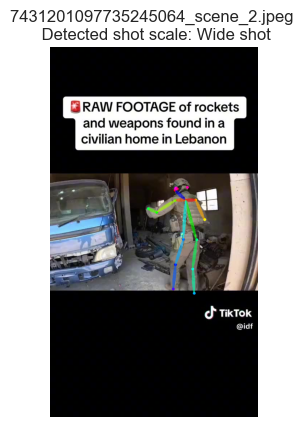

Scene: 7431201097735245064.mp4_scene_2 - Original: Full shot - Classified: Wide shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


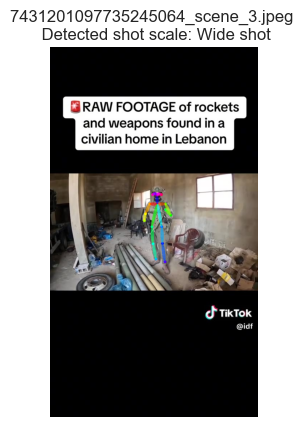

Scene: 7431201097735245064.mp4_scene_3 - Original: Full shot - Classified: Wide shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


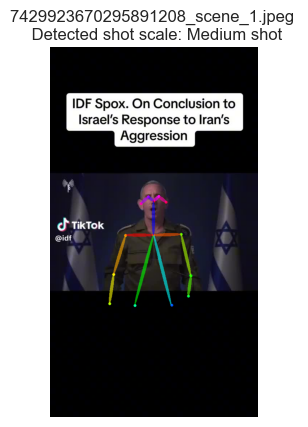

Scene: 7429923670295891208.mp4_scene_1 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


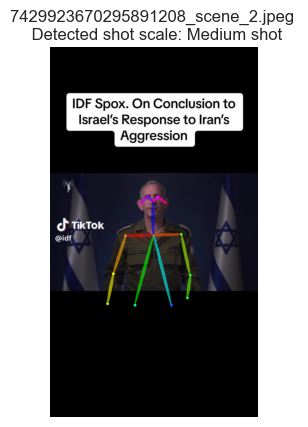

Scene: 7429923670295891208.mp4_scene_2 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


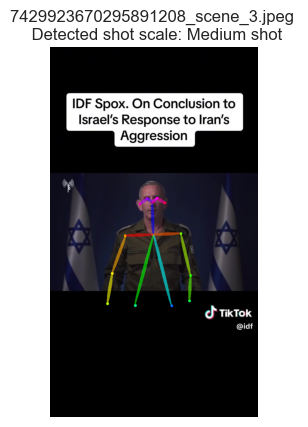

Scene: 7429923670295891208.mp4_scene_3 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


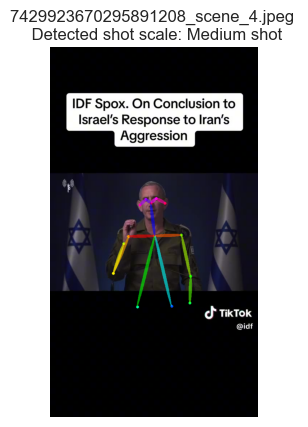

Scene: 7429923670295891208.mp4_scene_4 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


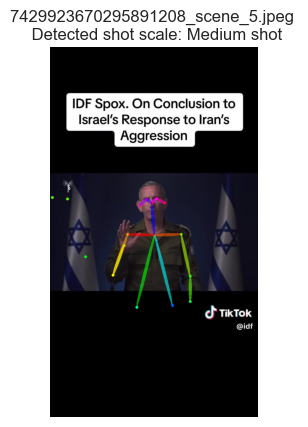

Scene: 7429923670295891208.mp4_scene_5 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 780ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


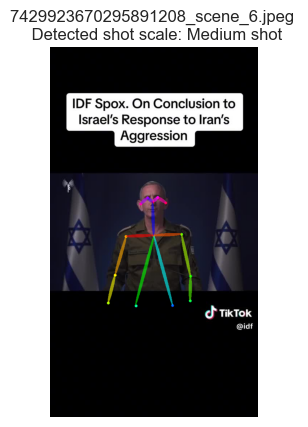

Scene: 7429923670295891208.mp4_scene_6 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


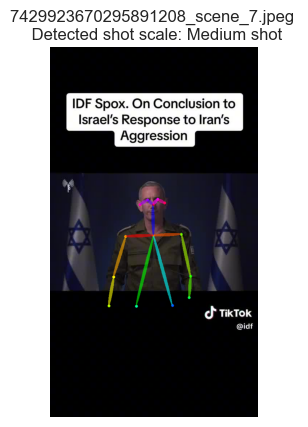

Scene: 7429923670295891208.mp4_scene_7 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


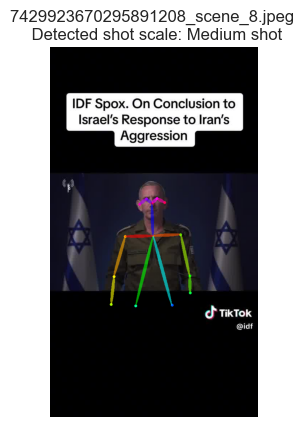

Scene: 7429923670295891208.mp4_scene_8 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


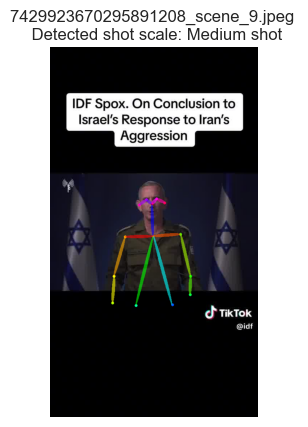

Scene: 7429923670295891208.mp4_scene_9 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 633ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


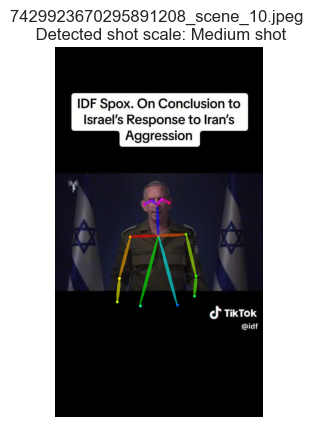

Scene: 7429923670295891208.mp4_scene_10 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


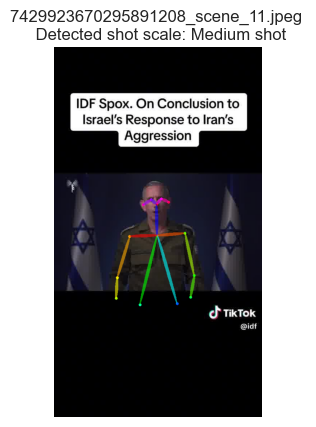

Scene: 7429923670295891208.mp4_scene_11 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 786ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


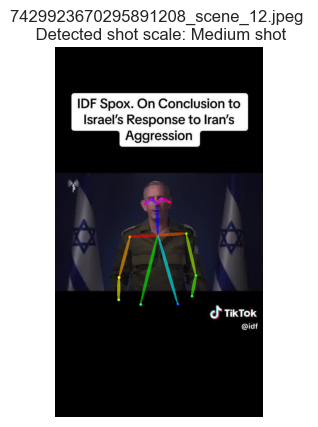

Scene: 7429923670295891208.mp4_scene_12 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


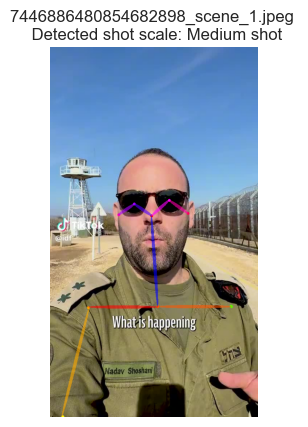

Scene: 7446886480854682898.mp4_scene_1 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


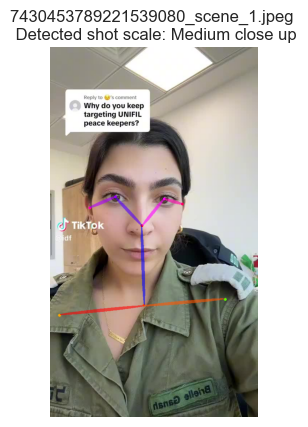

Scene: 7430453789221539080.mp4_scene_1 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 955ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


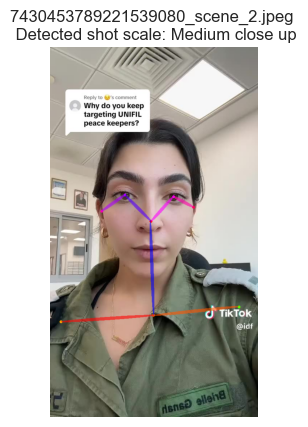

Scene: 7430453789221539080.mp4_scene_2 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


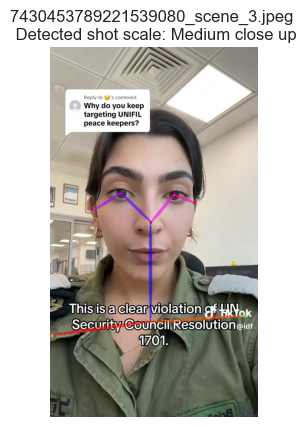

Scene: 7430453789221539080.mp4_scene_3 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


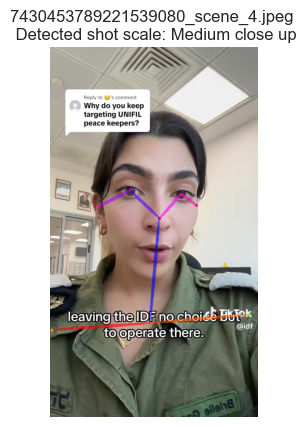

Scene: 7430453789221539080.mp4_scene_4 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


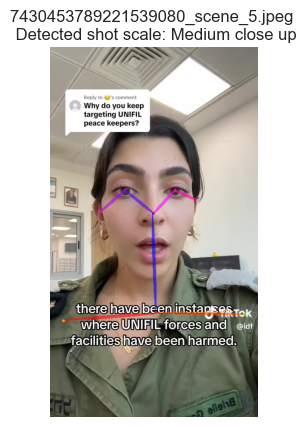

Scene: 7430453789221539080.mp4_scene_5 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 807ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


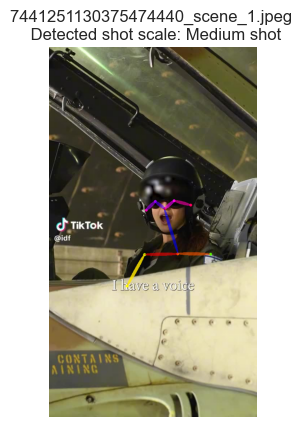

Scene: 7441251130375474440.mp4_scene_1 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


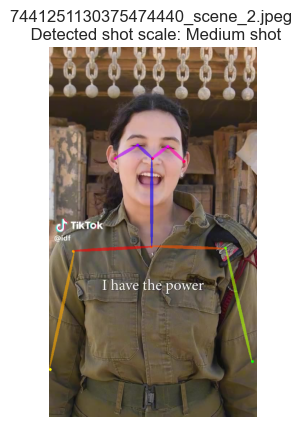

Scene: 7441251130375474440.mp4_scene_2 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


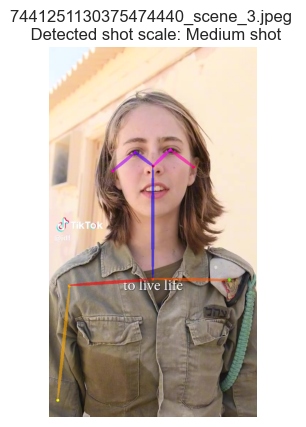

Scene: 7441251130375474440.mp4_scene_3 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


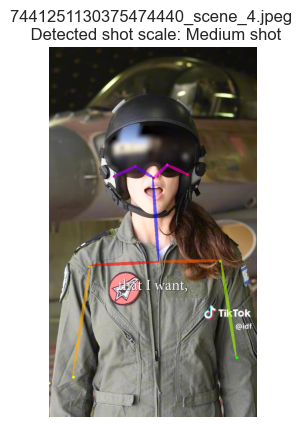

Scene: 7441251130375474440.mp4_scene_4 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


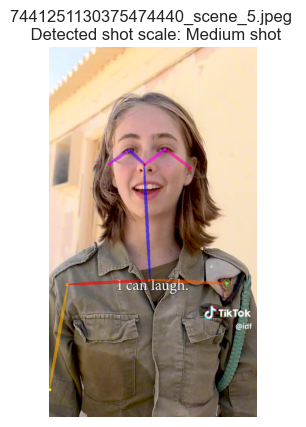

Scene: 7441251130375474440.mp4_scene_5 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


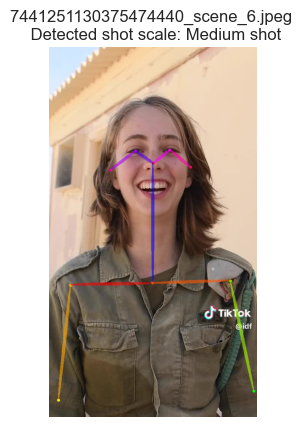

Scene: 7441251130375474440.mp4_scene_6 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 869ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


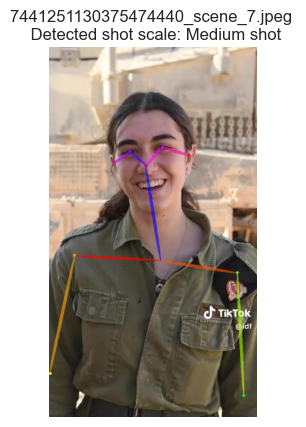

Scene: 7441251130375474440.mp4_scene_7 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


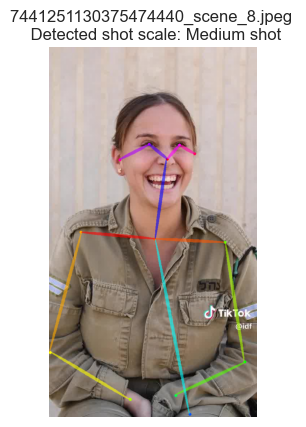

Scene: 7441251130375474440.mp4_scene_8 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


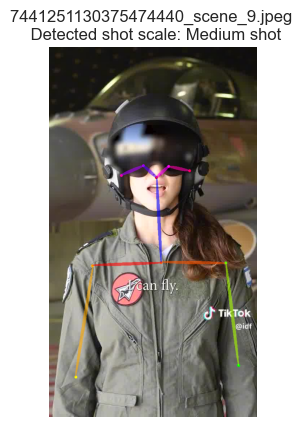

Scene: 7441251130375474440.mp4_scene_9 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


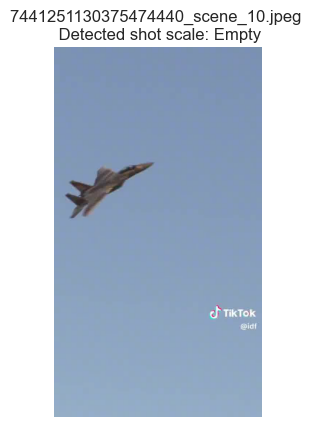

Scene: 7441251130375474440.mp4_scene_10 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


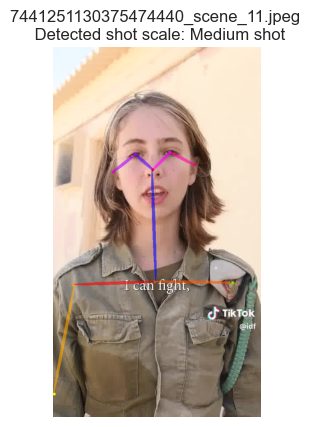

Scene: 7441251130375474440.mp4_scene_11 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


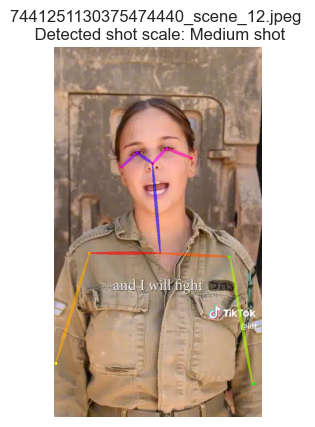

Scene: 7441251130375474440.mp4_scene_12 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 813ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


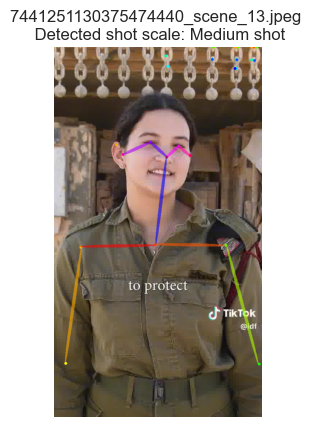

Scene: 7441251130375474440.mp4_scene_13 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


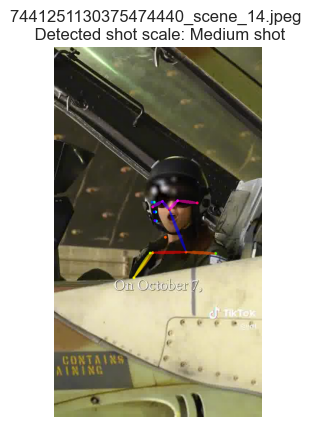

Scene: 7441251130375474440.mp4_scene_14 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


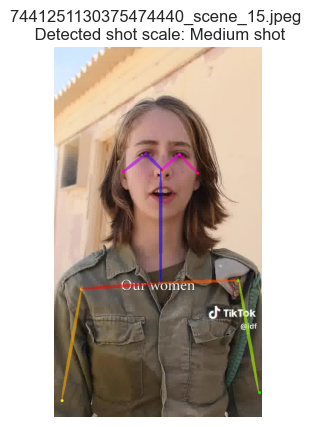

Scene: 7441251130375474440.mp4_scene_15 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 915ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


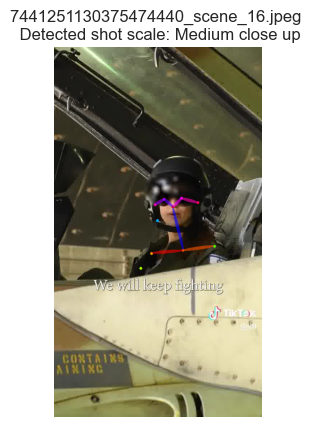

Scene: 7441251130375474440.mp4_scene_16 - Original: Medium shot - Classified: Medium close up
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


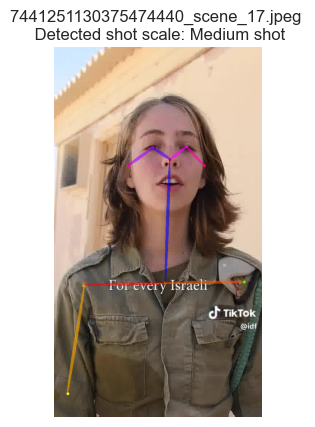

Scene: 7441251130375474440.mp4_scene_17 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


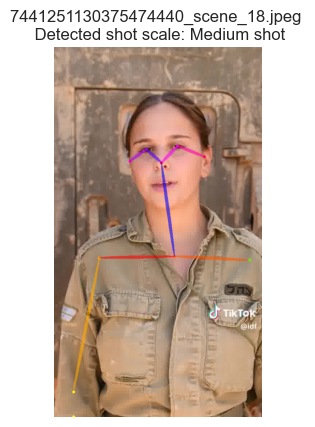

Scene: 7441251130375474440.mp4_scene_18 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


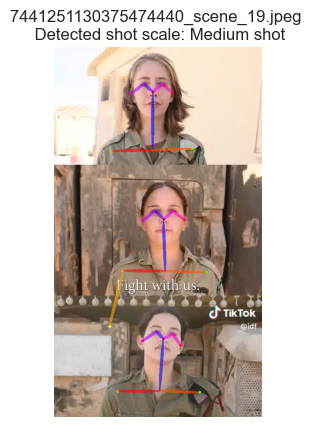

Scene: 7441251130375474440.mp4_scene_19 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


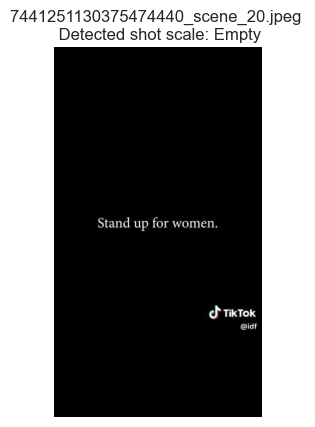

Scene: 7441251130375474440.mp4_scene_20 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


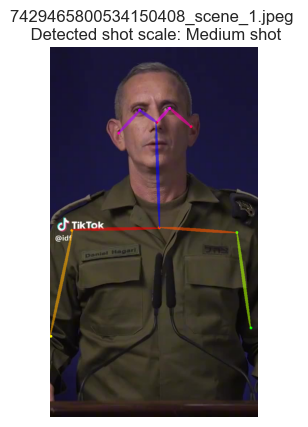

Scene: 7429465800534150408.mp4_scene_1 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


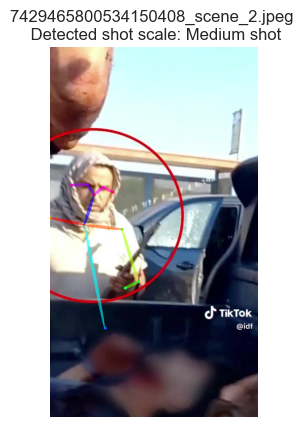

Scene: 7429465800534150408.mp4_scene_2 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


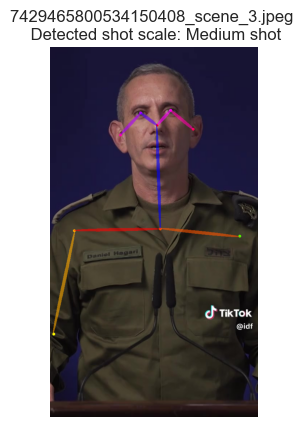

Scene: 7429465800534150408.mp4_scene_3 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


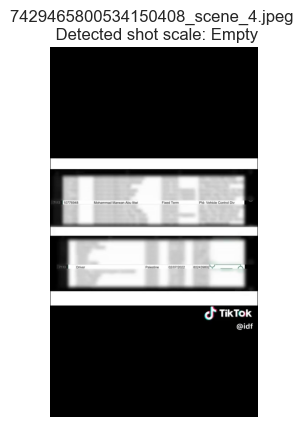

Scene: 7429465800534150408.mp4_scene_4 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


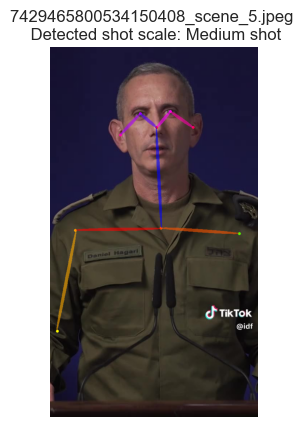

Scene: 7429465800534150408.mp4_scene_5 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


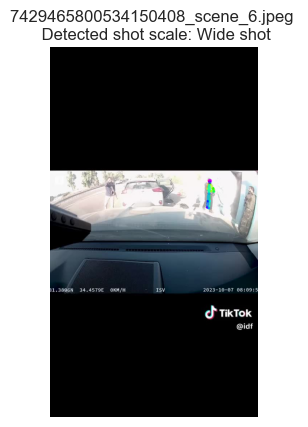

Scene: 7429465800534150408.mp4_scene_6 - Original: Wide shot - Classified: Wide shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


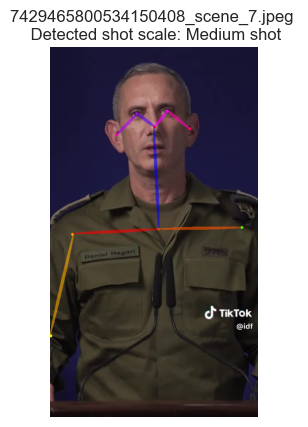

Scene: 7429465800534150408.mp4_scene_7 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


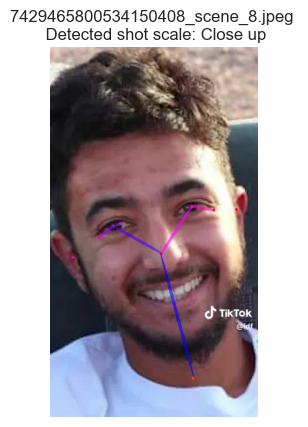

Scene: 7429465800534150408.mp4_scene_8 - Original: Close up - Classified: Close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


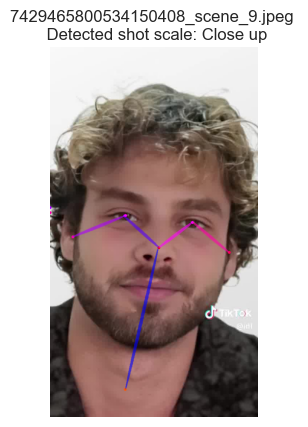

Scene: 7429465800534150408.mp4_scene_9 - Original: Close up - Classified: Close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


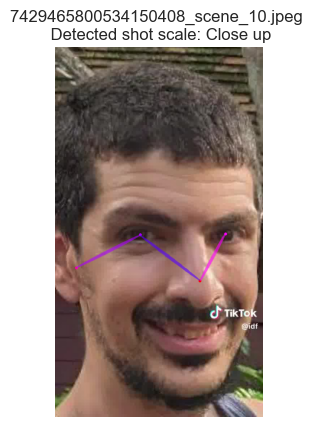

Scene: 7429465800534150408.mp4_scene_10 - Original: Close up - Classified: Close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


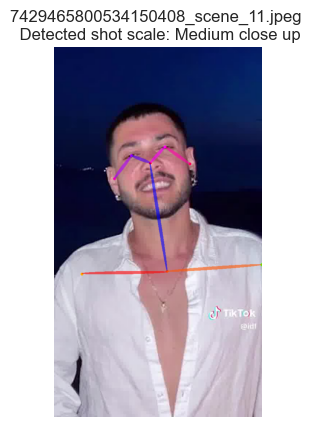

Scene: 7429465800534150408.mp4_scene_11 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


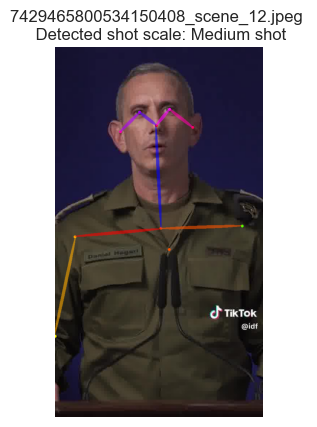

Scene: 7429465800534150408.mp4_scene_12 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 928ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


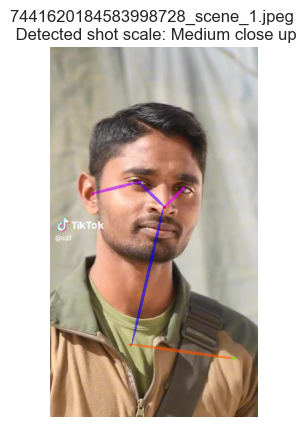

Scene: 7441620184583998728.mp4_scene_1 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


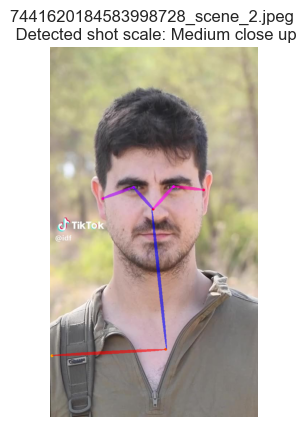

Scene: 7441620184583998728.mp4_scene_2 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


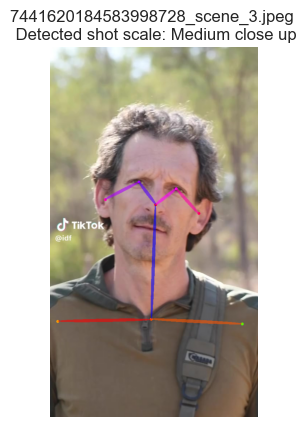

Scene: 7441620184583998728.mp4_scene_3 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


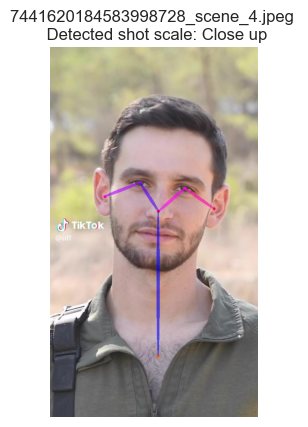

Scene: 7441620184583998728.mp4_scene_4 - Original: Medium close up - Classified: Close up
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


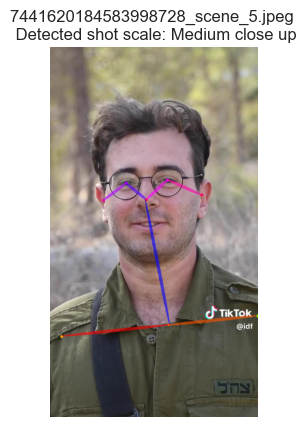

Scene: 7441620184583998728.mp4_scene_5 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 844ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


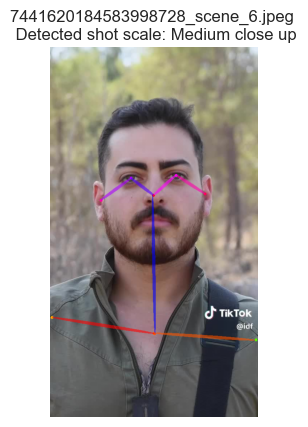

Scene: 7441620184583998728.mp4_scene_6 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


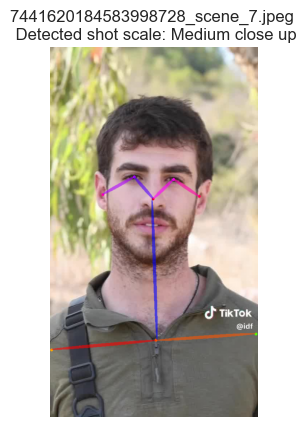

Scene: 7441620184583998728.mp4_scene_7 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 664ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


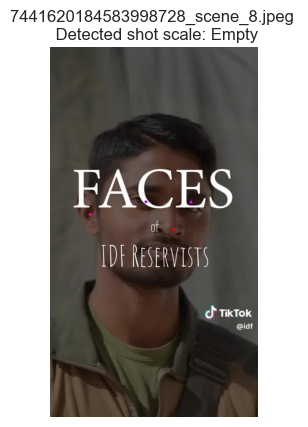

Scene: 7441620184583998728.mp4_scene_8 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


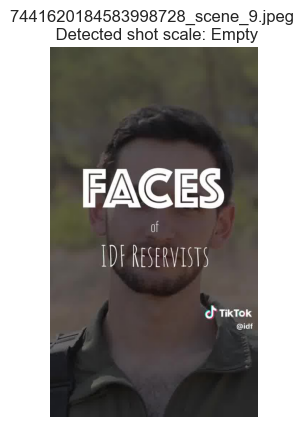

Scene: 7441620184583998728.mp4_scene_9 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


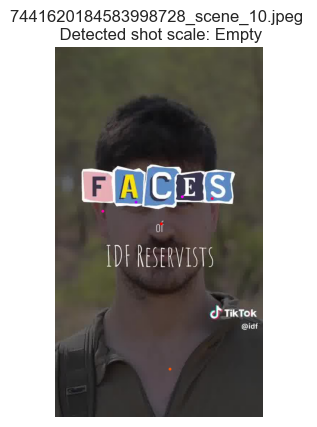

Scene: 7441620184583998728.mp4_scene_10 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


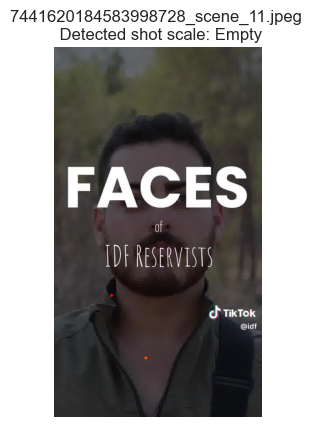

Scene: 7441620184583998728.mp4_scene_11 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


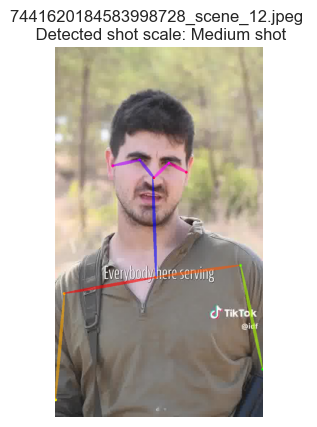

Scene: 7441620184583998728.mp4_scene_12 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


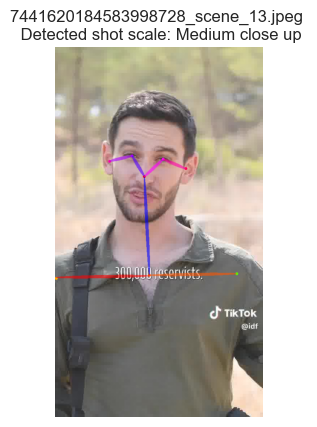

Scene: 7441620184583998728.mp4_scene_13 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


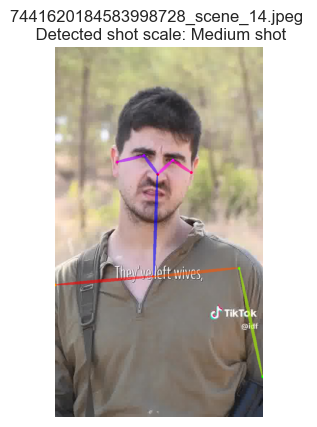

Scene: 7441620184583998728.mp4_scene_14 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 618ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


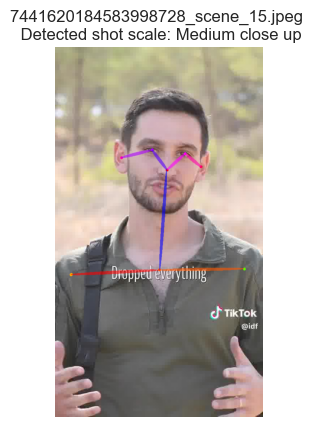

Scene: 7441620184583998728.mp4_scene_15 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


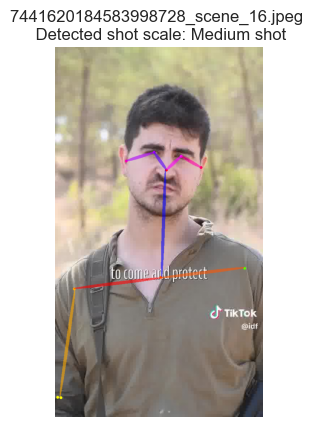

Scene: 7441620184583998728.mp4_scene_16 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


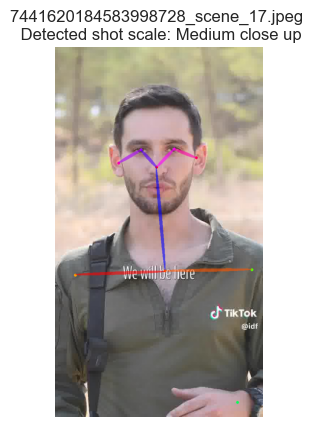

Scene: 7441620184583998728.mp4_scene_17 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


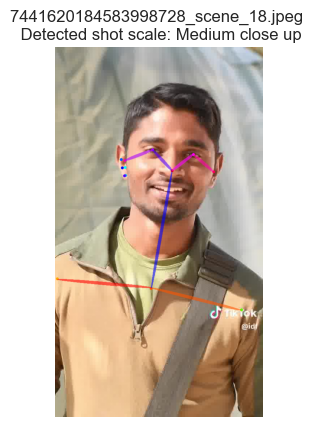

Scene: 7441620184583998728.mp4_scene_18 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


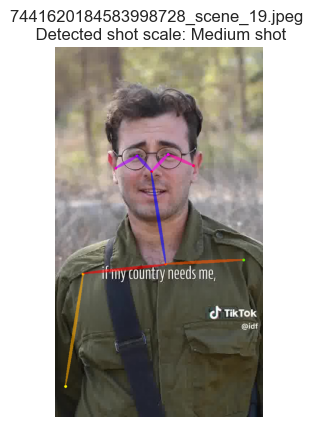

Scene: 7441620184583998728.mp4_scene_19 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


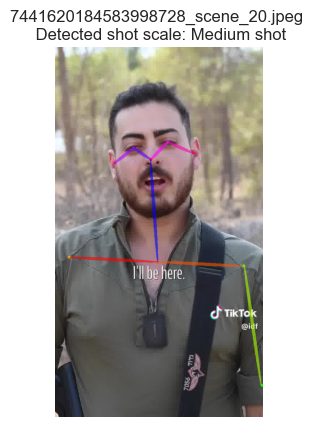

Scene: 7441620184583998728.mp4_scene_20 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


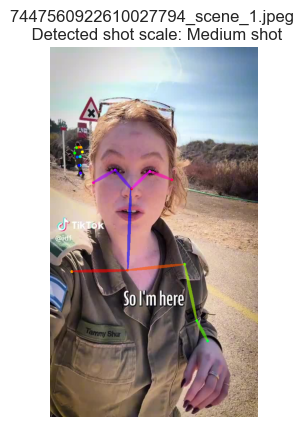

Scene: 7447560922610027794.mp4_scene_1 - Original: Medium close up - Classified: Medium shot
No match



In [ ]:
# Loop through scene dataframe and apply shot scale classification
%matplotlib inline

for index, scene in df_scene.iterrows():
    video_id = scene['url']
    scene_id = scene['id']

    cleaned_id = re.sub(r'\.mp4', '', scene_id)
    image_path = os.path.join(frames_folder, str(video_id), f'{cleaned_id}.jpeg')
    # Add manually coded labels for validation
    coded_shot_scale = scene['shot_scale_m']
    shot_scale = get_shot_scale(image_path)
    # plt.savefig(f'shot_scale_results/{cleaned_id}.svg')
    plt.show()
    # Tuning prints if needed to show the original labels
    print(f'Scene: {scene_id} - Original: {coded_shot_scale} - Classified: {shot_scale}')
    if coded_shot_scale != shot_scale:
        print('No match')
    print()

    df_scene.at[index, 'shot_scale_classifier'] = shot_scale

### Evaluate algorithm

In [ ]:
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import seaborn as sns

In [ ]:
def plot_confusion_matrix(df, col1, col2, labels=None, title="Confusion Matrix"):
    """
    Generates and plots a confusion matrix comparing the classifications
    between two columns in a DataFrame.
    PLEASE REMEMBER TO CALL plt.show() separately!
    Args:
        df (pd.DataFrame):  Input DataFrame.
        col1 (str): The name of the first column
        col2 (str): The name of the second column
        labels (list, optional): A list of unique labels to consider. If None,
                                 the unique labels from both columns will be used.
        title (str, optional): The title of the plot. Defaults to "Confusion Matrix".
    """
    # Drop rows where either column has a missing value (NaN)
    df_cleaned = df.dropna(subset=[col1, col2]).copy()

    # Get the labels
    y_true = df_cleaned[col1]
    y_pred = df_cleaned[col2]

    if labels is None:
        # Get all unique labels from both columns
        all_labels = sorted(list(set(y_true) | set(y_pred)))
        labels = all_labels

    # Compute the confusion matrix
    cm = confusion_matrix(y_true, y_pred, labels=labels)

    # Plot the confusion matrix using seaborn
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel(f'Column 2: ({col2})')
    plt.ylabel(f'Column 1: ({col1})')
    plt.title(title)

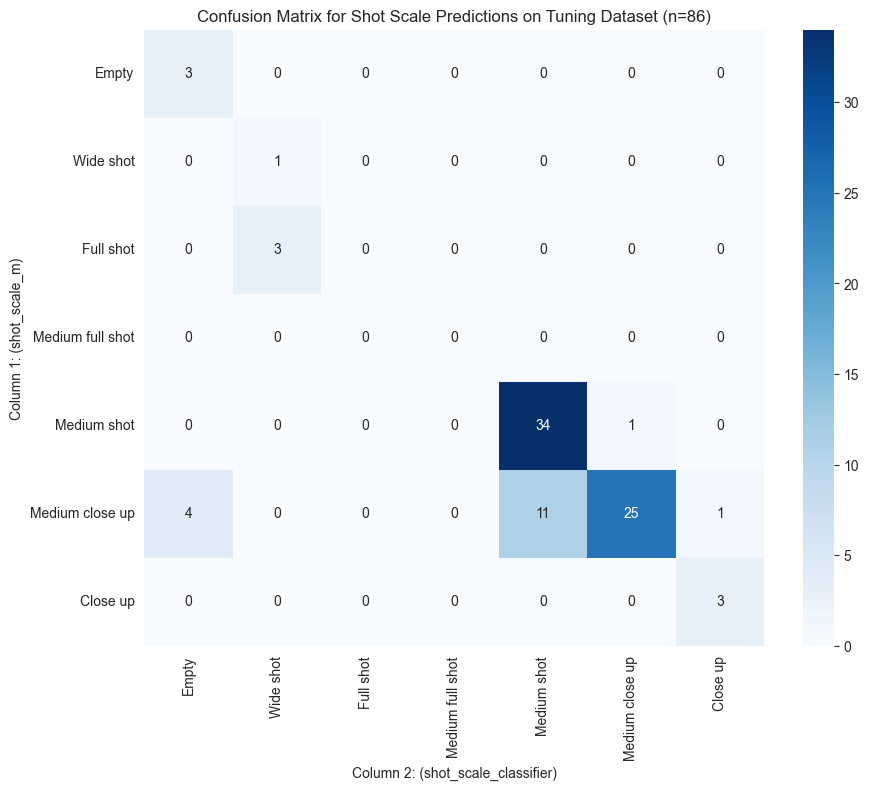

In [ ]:
# Generate the confusion matrix
plot_confusion_matrix(df_scene,
                      'shot_scale_m',
                      'shot_scale_classifier',
                      ['Empty',
                       'Wide shot',
                       'Full shot',
                       'Medium full shot',
                       'Medium shot', 'Medium close up', 'Close up'],
                      title = "Confusion Matrix for Shot Scale Predictions on Tuning Dataset (n=86)")

plt.show()

In [ ]:
# Calc intercoder agreement
import krippendorff
def calc_k_alpha_shot_scale_ord(df, col_list):

    """
    Calculates Krippendorff's Alpha (for ordinal variables) for shot scale annotations. It converts 'Uncertain' to NaN.

    This function takes a df and a list of column names containing
    shot scale annotations as input and calculates K Alpha.

    Args:
        df (pd.DataFrame): The input DataFrame containing shot scale annotations.
        col_list (list): A list of column names in the DataFrame that contain
                         the shot scale annotations to be compared.

    Returns:
        tuple: A tuple containing:
            - alpha (float): The calculated Krippendorff's Alpha value.
            - rows_with_nan (int): The number of rows that contained at least
                                   one 'Uncertain' value (which were converted to NaN
                                   and excluded from the alpha calculation).
    """

    # Define ordinal scale for refactoring
    # Ordered from closest to further from the camera
    ordinal_scale = {
        'Close up': 1,
        'Medium close up': 2,
        'Medium shot': 3,
        'Medium full shot': 4,
        'Full shot' : 5,
        'Wide shot': 6,
        'Empty': 7,
        'Uncertain': np.nan, # Exclude NaN (NaN has to be excluded in ordinal scale or include as a separate category in nominal)
        }

    df_copy = df[col_list].copy() # Make copy of dataframe for refactoring; Only the desired columns

    # Check for values not in the ordinal_scale and replace with NaN
    for col in col_list:
        unmappable_values = df_copy[col][~df_copy[col].isin(ordinal_scale.keys())].unique()
        if len(unmappable_values) > 0:
            print(f"Warning: Unmappable values found in column '{col}' ({len(unmappable_values)}): \n{unmappable_values}. Replacing with NaN.")
            df_copy[col] = df_copy[col].replace(unmappable_values, np.nan)

    # Refactor
    for col in col_list:
        df_copy[col] = df_copy[col].map(ordinal_scale)

    # Count the number of rows with at least one NaN value in the specified columns
    rows_with_nan = df_copy[df_copy.isnull().any(axis=1)].shape[0]
    print(f"Number of rows with NaN values/'Uncertain' (excluded from calculation): {rows_with_nan}")

    # Transpose for krippendorff
    data_array = df_copy[col_list].to_numpy().T

    # Compute alpha
    alpha = krippendorff.alpha(reliability_data=data_array, level_of_measurement='ordinal')
    print(f"Krippendorff’s alpha (ordinal) for {col_list}: {alpha:.3f}")
    return alpha, rows_with_nan


In [ ]:
calc_k_alpha_shot_scale_ord(df_scene,['shot_scale_m','shot_scale_classifier'])

Number of rows with NaN values/'Uncertain' (excluded from calculation): 0
Krippendorff’s alpha (ordinal) for ['shot_scale_m', 'shot_scale_classifier']: 0.636


(0.6364343696945272, 0)

In [ ]:
f1 = f1_score(df_scene['shot_scale_m'], df_scene['shot_scale_classifier'], average='weighted')
f1

0.7571912034511827

In [ ]:
print(classification_report(df_scene['shot_scale_m'], df_scene['shot_scale_classifier']))

                 precision    recall  f1-score   support

       Close up       0.75      1.00      0.86         3
          Empty       0.43      1.00      0.60         3
      Full shot       0.00      0.00      0.00         3
Medium close up       0.96      0.61      0.75        41
    Medium shot       0.76      0.97      0.85        35
      Wide shot       0.25      1.00      0.40         1

       accuracy                           0.77        86
      macro avg       0.52      0.76      0.58        86
   weighted avg       0.81      0.77      0.76        86



/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no 

The classification logic and algorithm particularly struggles if the figure is obscured (read as empty) and in angled perspectives, especially when the selfie camera is used. This is seen in the misclassification of medium close up selfies as medium shots due to the presence of a raised elbow, which would traditionally be by the side of the body and indicate a medium shot. Elbows were used as an indicator of medium shots due to hips being an insufficient indicator as the waist is slighly above the hips. Hips being obscured or not visible would lead to medium shots not being able to be classified correctly.

This is reflective of the classification difficulty for 'medium close ups' in particular when there is no keypoint for chest. Otherwise, an average 75% F1 is acceptable.


## Test on other dataset
Applying it to a separate dataset of 95 thumbnails from 5 videos for final validation.

In [ ]:
df_scene_test = pd.read_csv('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_merged.csv')
frames_folder = '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1'

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


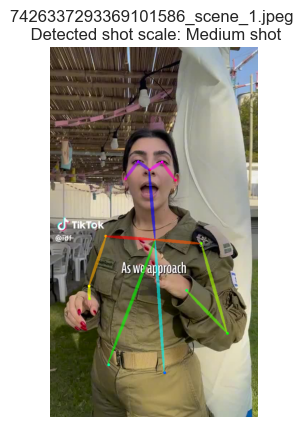

Scene: 7426337293369101586.mp4_scene_1 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


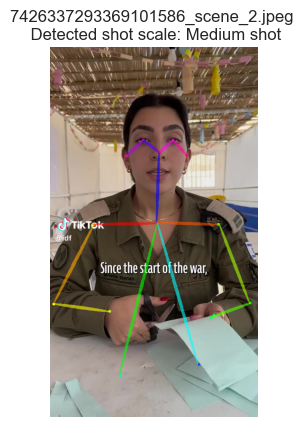

Scene: 7426337293369101586.mp4_scene_2 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


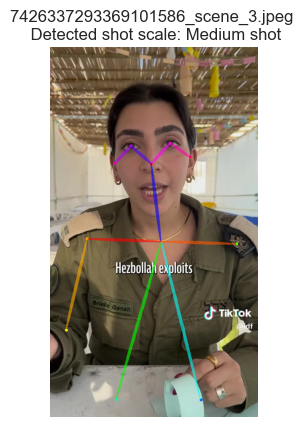

Scene: 7426337293369101586.mp4_scene_3 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


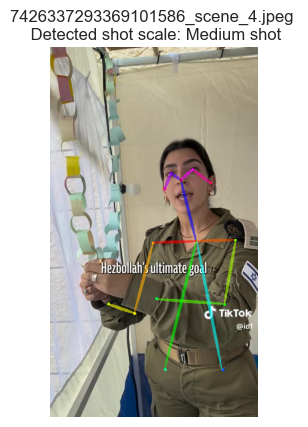

Scene: 7426337293369101586.mp4_scene_4 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


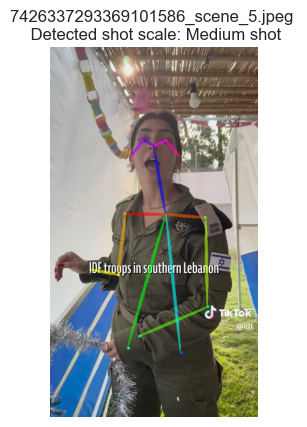

Scene: 7426337293369101586.mp4_scene_5 - Original: Medium full shot - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


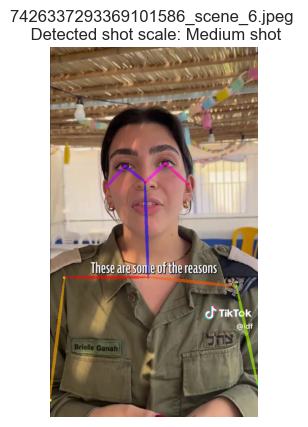

Scene: 7426337293369101586.mp4_scene_6 - Original: Medium close up - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


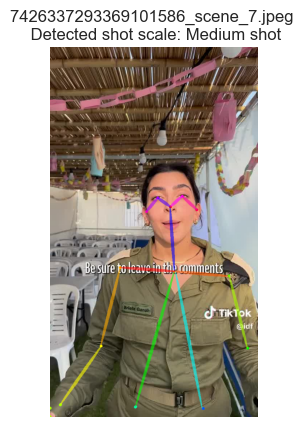

Scene: 7426337293369101586.mp4_scene_7 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


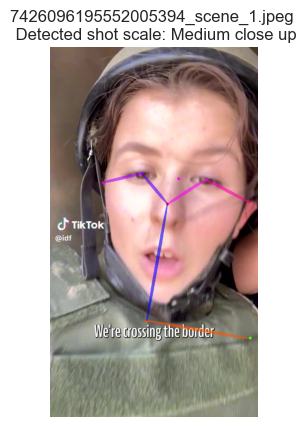

Scene: 7426096195552005394.mp4_scene_1 - Original: Close up - Classified: Medium close up
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


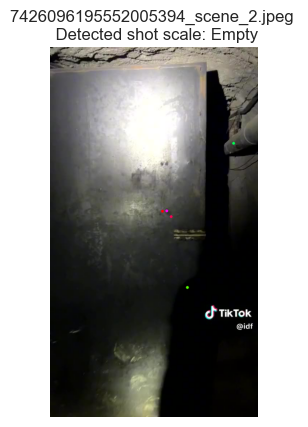

Scene: 7426096195552005394.mp4_scene_2 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


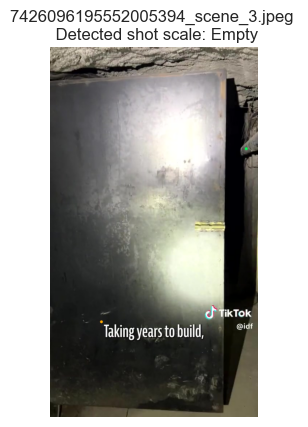

Scene: 7426096195552005394.mp4_scene_3 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


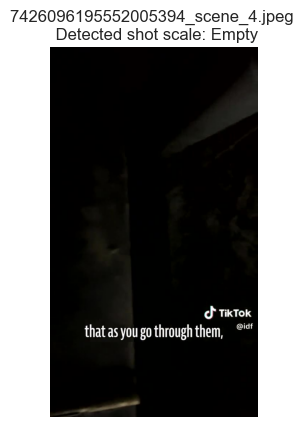

Scene: 7426096195552005394.mp4_scene_4 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


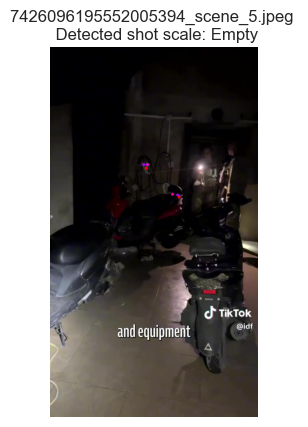

Scene: 7426096195552005394.mp4_scene_5 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


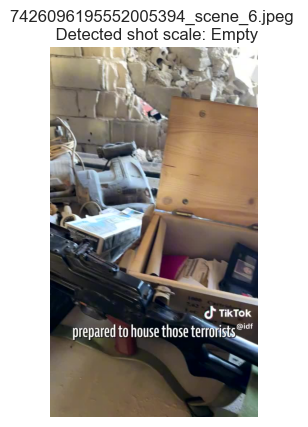

Scene: 7426096195552005394.mp4_scene_6 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


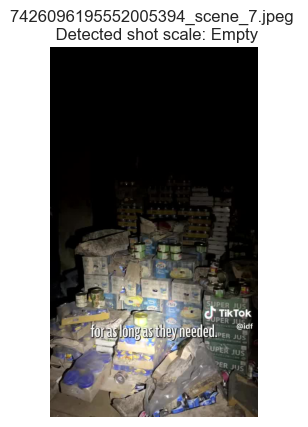

Scene: 7426096195552005394.mp4_scene_7 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


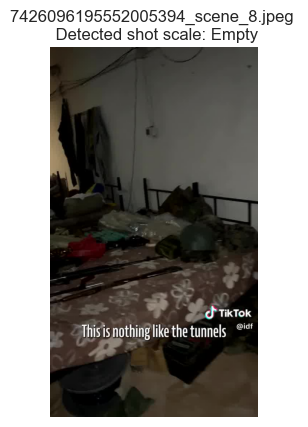

Scene: 7426096195552005394.mp4_scene_8 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


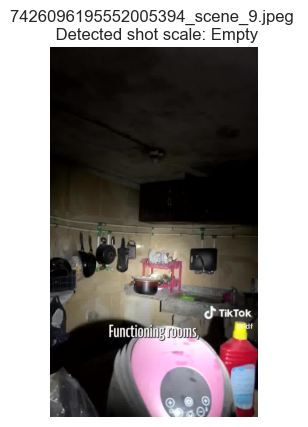

Scene: 7426096195552005394.mp4_scene_9 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


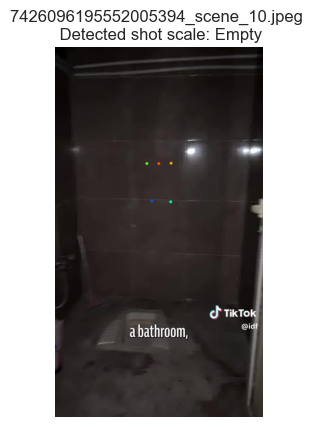

Scene: 7426096195552005394.mp4_scene_10 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


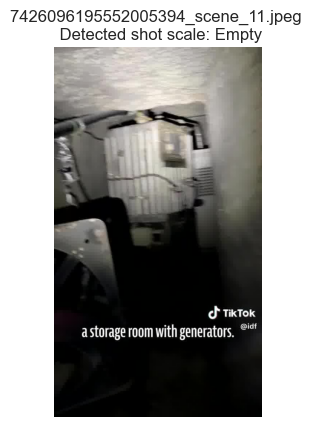

Scene: 7426096195552005394.mp4_scene_11 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


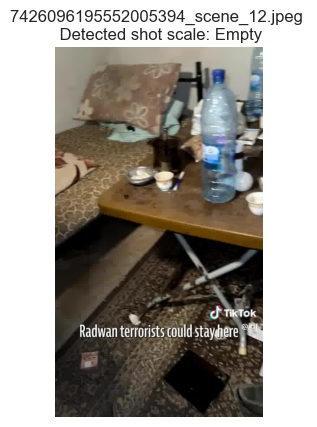

Scene: 7426096195552005394.mp4_scene_12 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 755ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


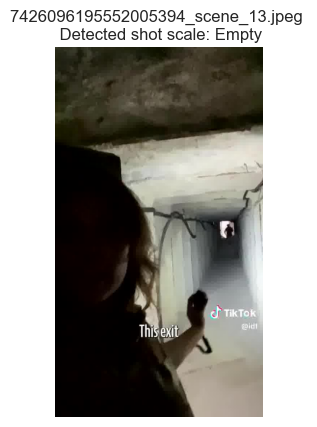

Scene: 7426096195552005394.mp4_scene_13 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


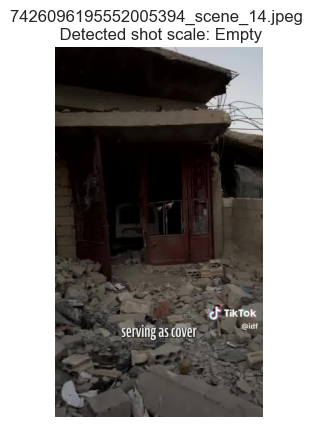

Scene: 7426096195552005394.mp4_scene_14 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


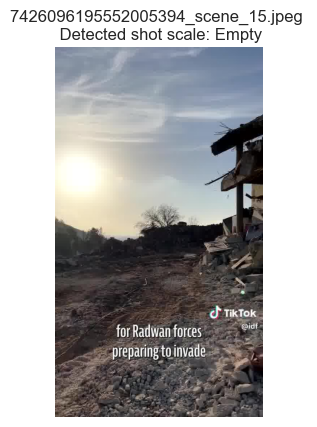

Scene: 7426096195552005394.mp4_scene_15 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 832ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


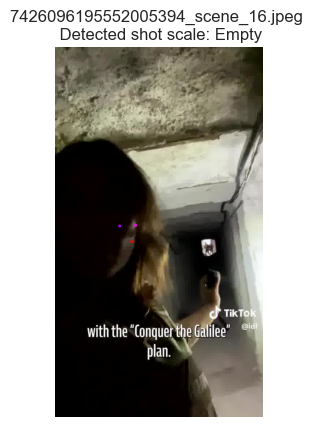

Scene: 7426096195552005394.mp4_scene_16 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


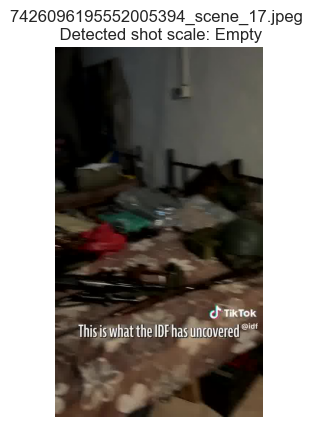

Scene: 7426096195552005394.mp4_scene_17 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


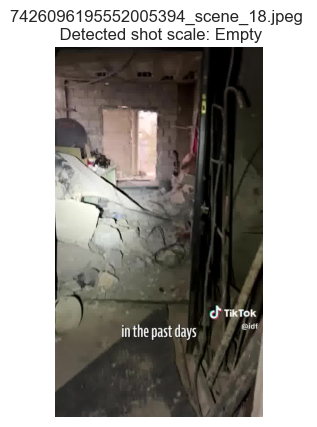

Scene: 7426096195552005394.mp4_scene_18 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


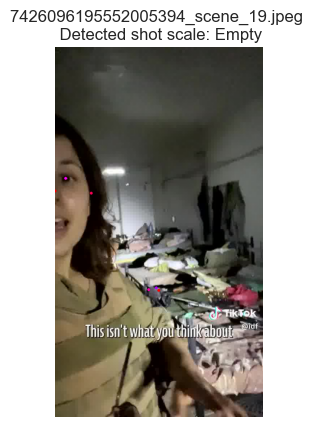

Scene: 7426096195552005394.mp4_scene_19 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 688ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


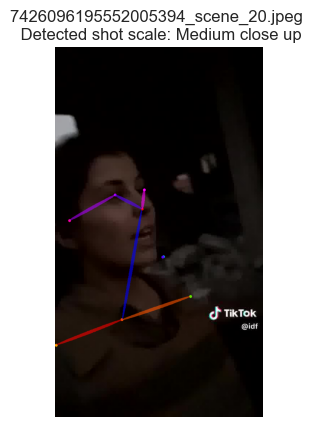

Scene: 7426096195552005394.mp4_scene_20 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 860ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


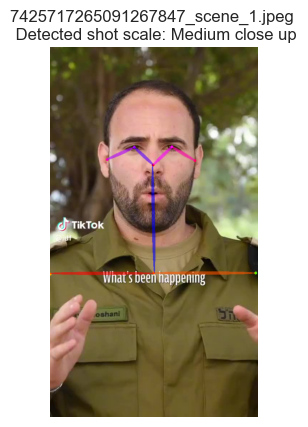

Scene: 7425717265091267847.mp4_scene_1 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


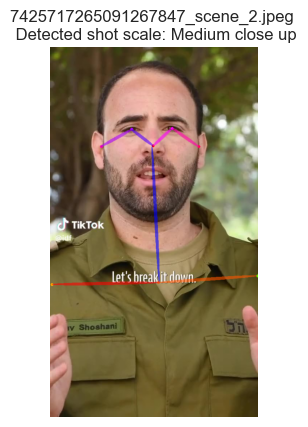

Scene: 7425717265091267847.mp4_scene_2 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


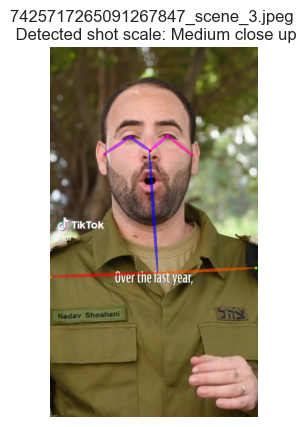

Scene: 7425717265091267847.mp4_scene_3 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


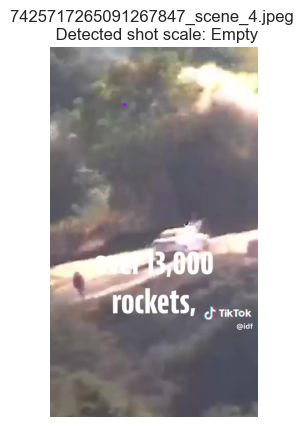

Scene: 7425717265091267847.mp4_scene_4 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


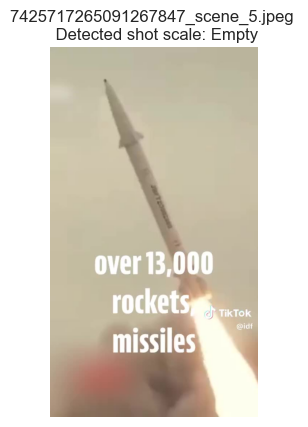

Scene: 7425717265091267847.mp4_scene_5 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 737ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


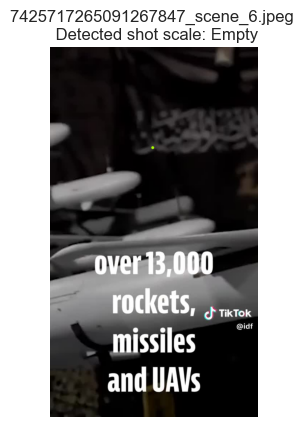

Scene: 7425717265091267847.mp4_scene_6 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 740ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


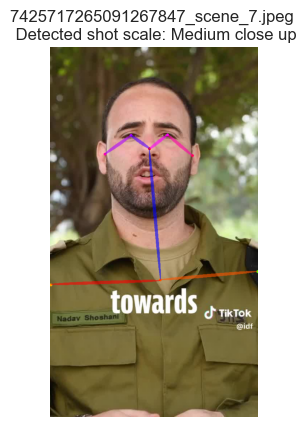

Scene: 7425717265091267847.mp4_scene_7 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


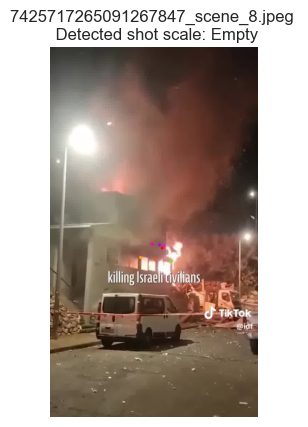

Scene: 7425717265091267847.mp4_scene_8 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step


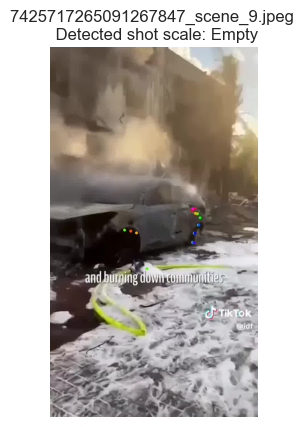

Scene: 7425717265091267847.mp4_scene_9 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 811ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


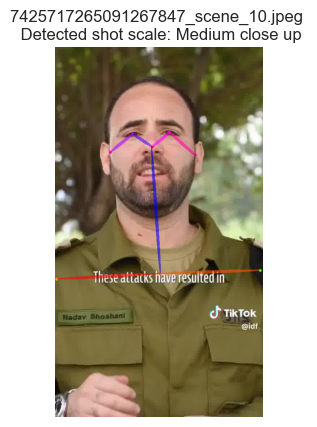

Scene: 7425717265091267847.mp4_scene_10 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 729ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


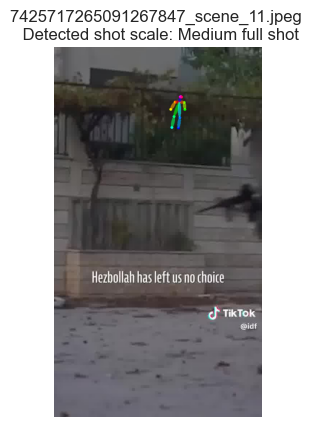

Scene: 7425717265091267847.mp4_scene_11 - Original: Empty - Classified: Medium full shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


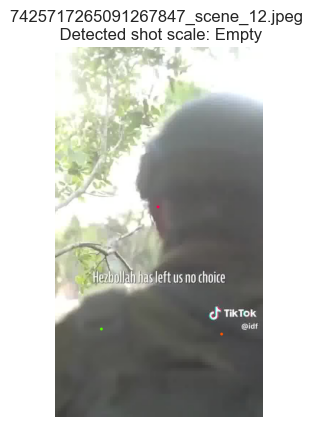

Scene: 7425717265091267847.mp4_scene_12 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


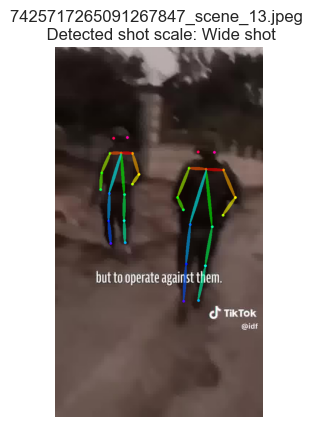

Scene: 7425717265091267847.mp4_scene_13 - Original: Empty - Classified: Wide shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 820ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


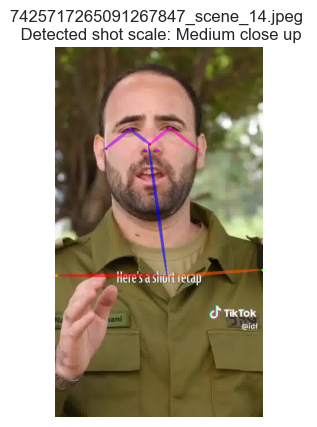

Scene: 7425717265091267847.mp4_scene_14 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


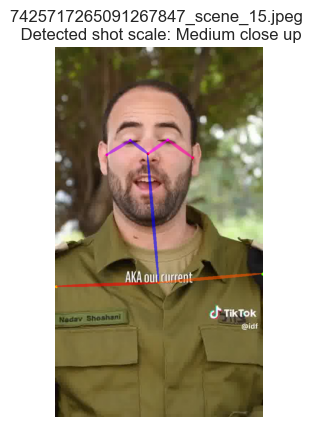

Scene: 7425717265091267847.mp4_scene_15 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


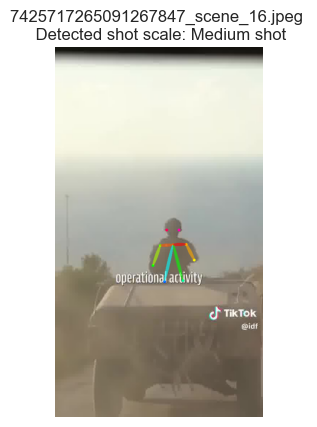

Scene: 7425717265091267847.mp4_scene_16 - Original: Empty - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 917ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


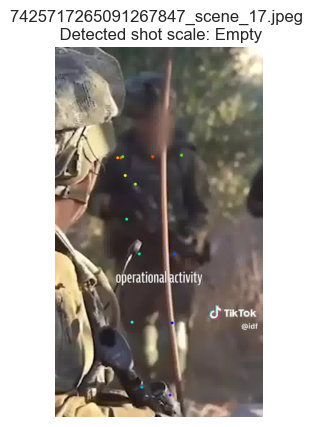

Scene: 7425717265091267847.mp4_scene_17 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


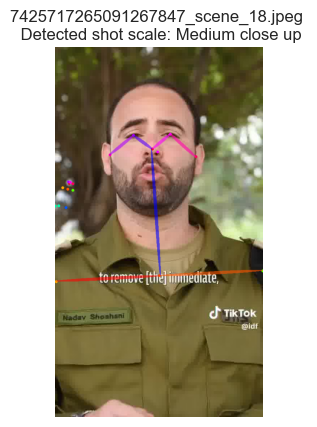

Scene: 7425717265091267847.mp4_scene_18 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


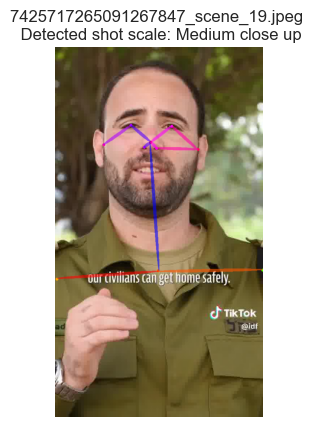

Scene: 7425717265091267847.mp4_scene_19 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


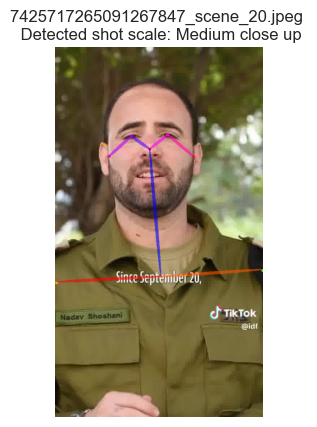

Scene: 7425717265091267847.mp4_scene_20 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


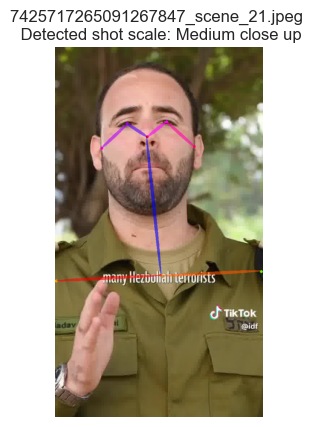

Scene: 7425717265091267847.mp4_scene_21 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 733ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


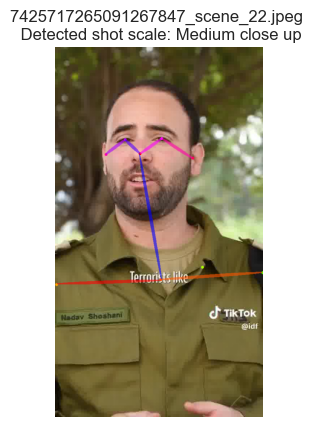

Scene: 7425717265091267847.mp4_scene_22 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


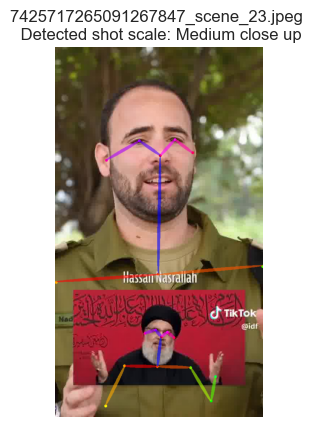

Scene: 7425717265091267847.mp4_scene_23 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


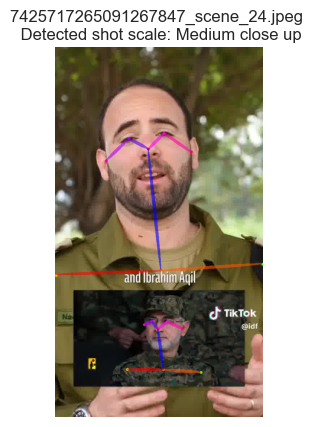

Scene: 7425717265091267847.mp4_scene_24 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


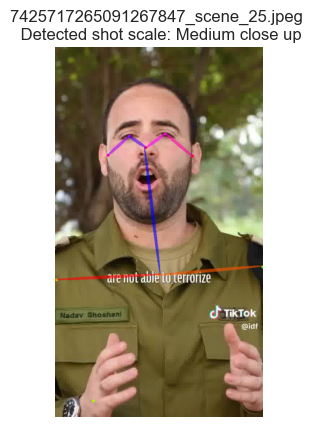

Scene: 7425717265091267847.mp4_scene_25 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


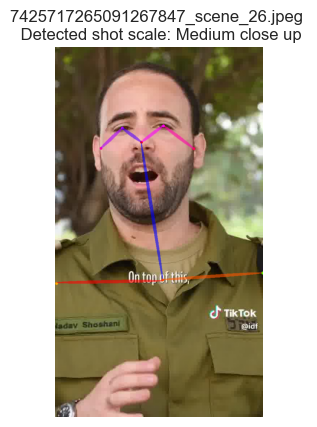

Scene: 7425717265091267847.mp4_scene_26 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


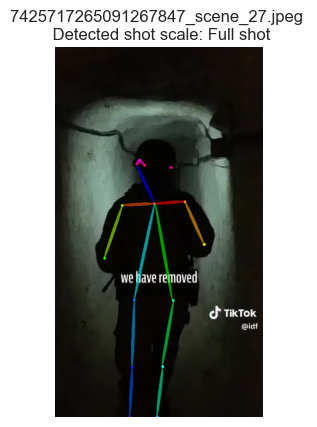

Scene: 7425717265091267847.mp4_scene_27 - Original: Empty - Classified: Full shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


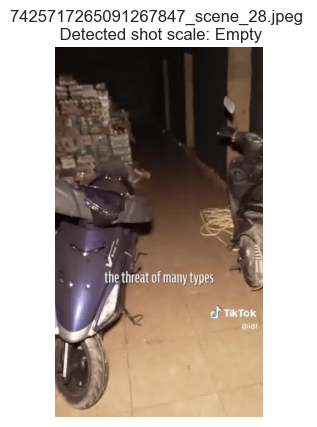

Scene: 7425717265091267847.mp4_scene_28 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


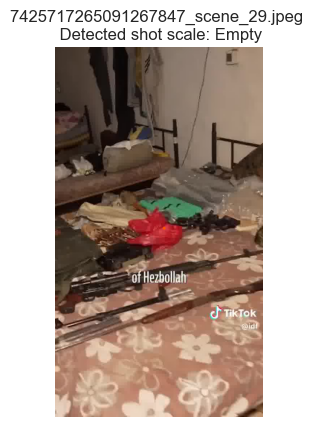

Scene: 7425717265091267847.mp4_scene_29 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


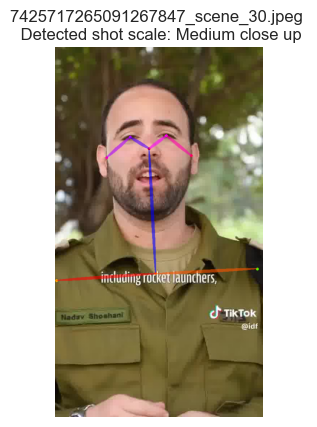

Scene: 7425717265091267847.mp4_scene_30 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


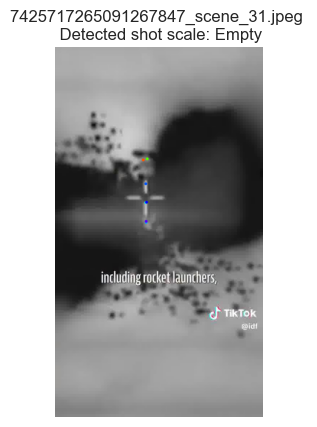

Scene: 7425717265091267847.mp4_scene_31 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


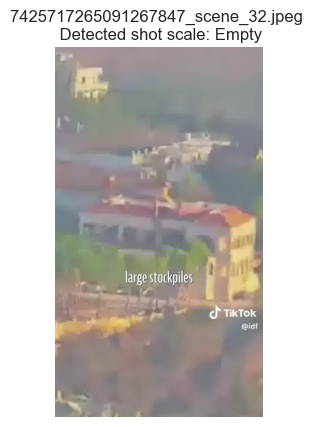

Scene: 7425717265091267847.mp4_scene_32 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


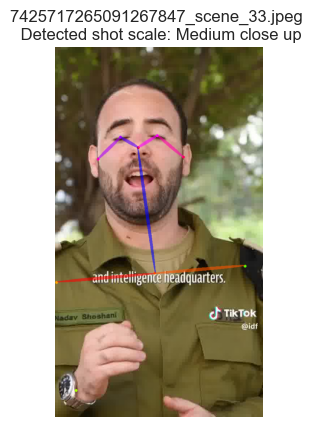

Scene: 7425717265091267847.mp4_scene_33 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


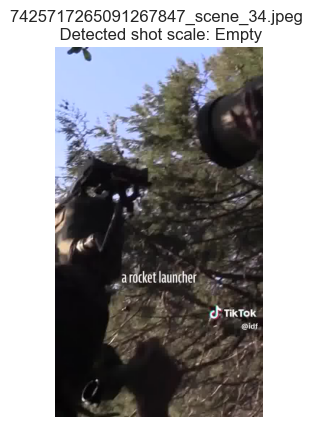

Scene: 7425717265091267847.mp4_scene_34 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


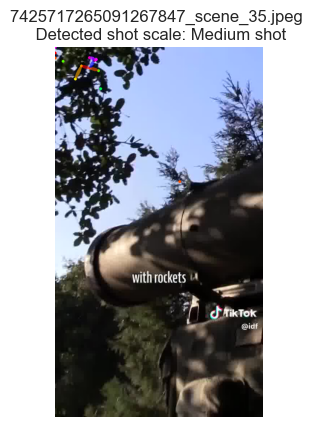

Scene: 7425717265091267847.mp4_scene_35 - Original: Empty - Classified: Medium shot
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


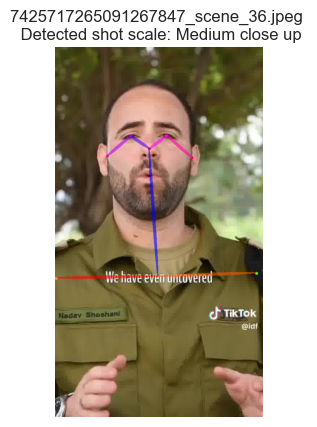

Scene: 7425717265091267847.mp4_scene_36 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


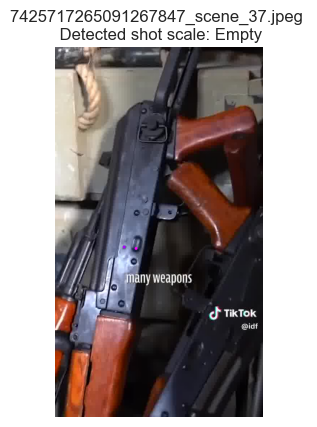

Scene: 7425717265091267847.mp4_scene_37 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


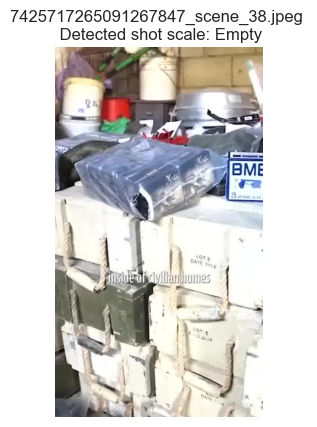

Scene: 7425717265091267847.mp4_scene_38 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 906ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


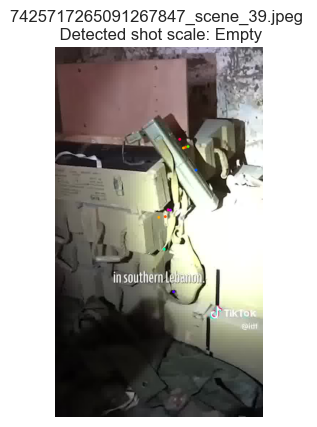

Scene: 7425717265091267847.mp4_scene_39 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


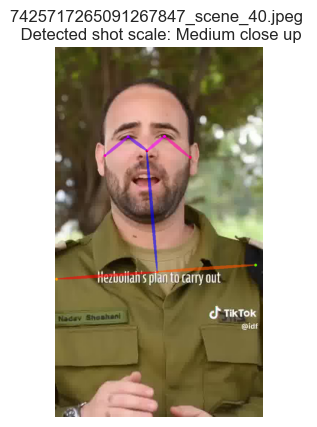

Scene: 7425717265091267847.mp4_scene_40 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


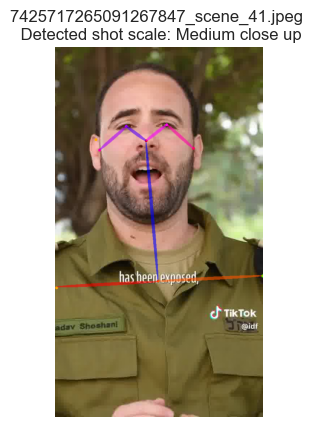

Scene: 7425717265091267847.mp4_scene_41 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 803ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


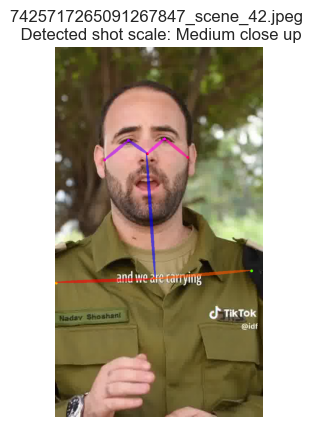

Scene: 7425717265091267847.mp4_scene_42 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


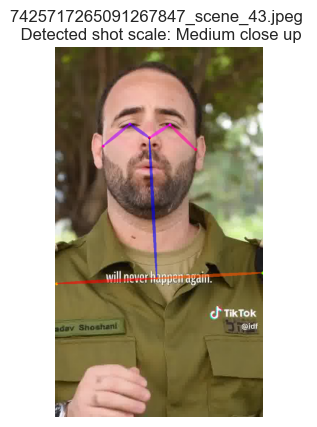

Scene: 7425717265091267847.mp4_scene_43 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


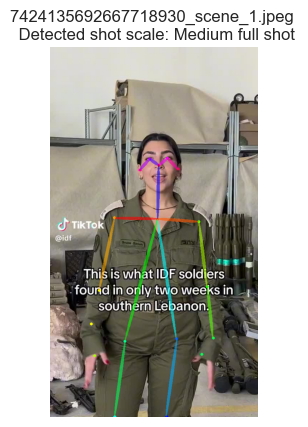

Scene: 7424135692667718930.mp4_scene_1 - Original: Medium full shot - Classified: Medium full shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


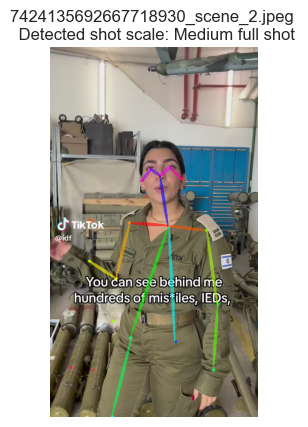

Scene: 7424135692667718930.mp4_scene_2 - Original: Medium full shot - Classified: Medium full shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


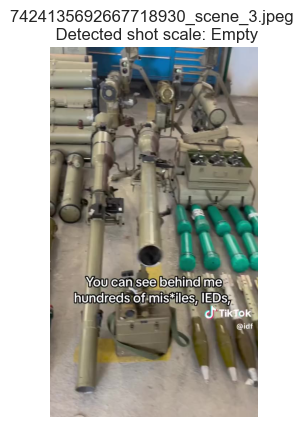

Scene: 7424135692667718930.mp4_scene_3 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


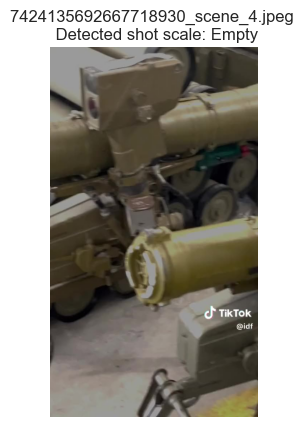

Scene: 7424135692667718930.mp4_scene_4 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


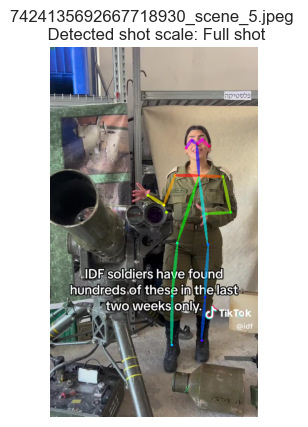

Scene: 7424135692667718930.mp4_scene_5 - Original: Full shot - Classified: Full shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


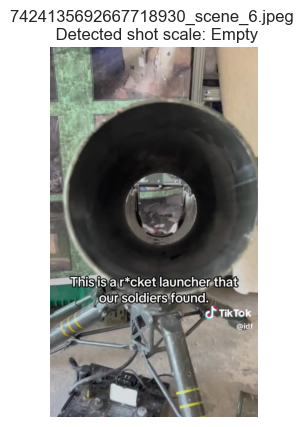

Scene: 7424135692667718930.mp4_scene_6 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


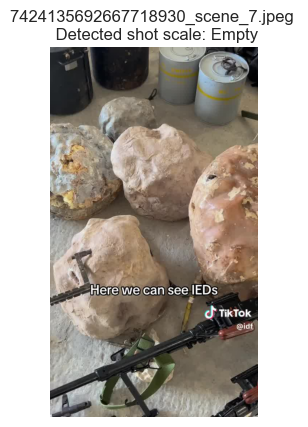

Scene: 7424135692667718930.mp4_scene_7 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


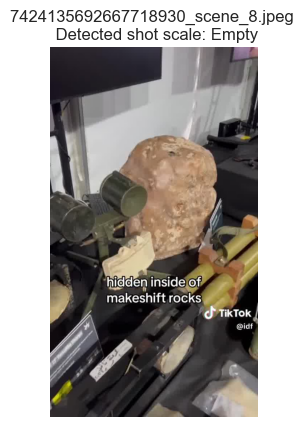

Scene: 7424135692667718930.mp4_scene_8 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


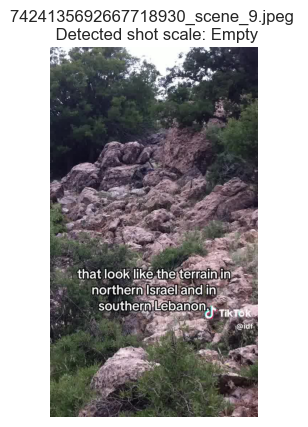

Scene: 7424135692667718930.mp4_scene_9 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


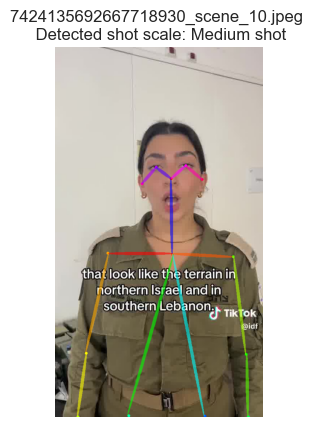

Scene: 7424135692667718930.mp4_scene_10 - Original: Medium shot - Classified: Medium shot

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


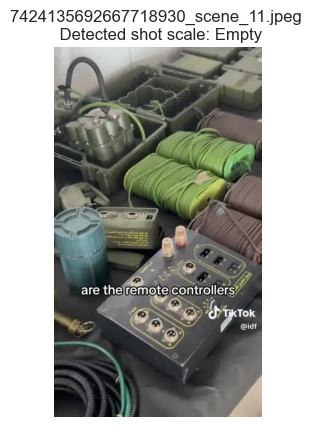

Scene: 7424135692667718930.mp4_scene_11 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


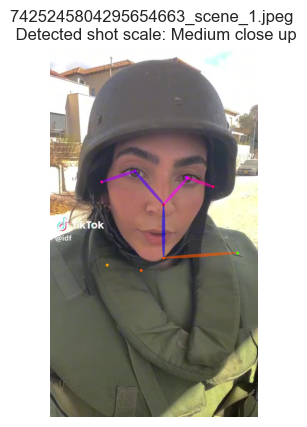

Scene: 7425245804295654663.mp4_scene_1 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 762ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


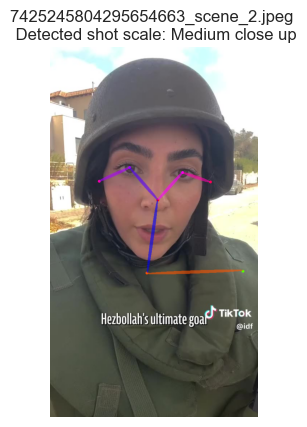

Scene: 7425245804295654663.mp4_scene_2 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


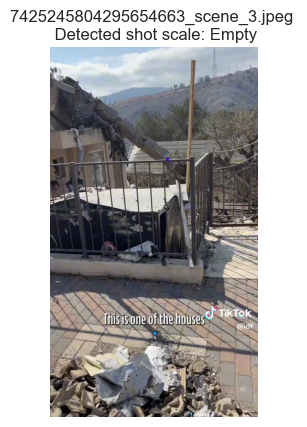

Scene: 7425245804295654663.mp4_scene_3 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


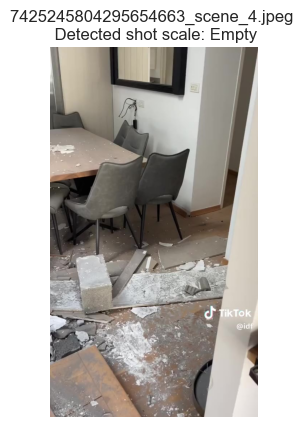

Scene: 7425245804295654663.mp4_scene_4 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


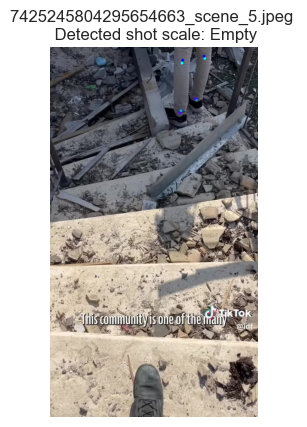

Scene: 7425245804295654663.mp4_scene_5 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


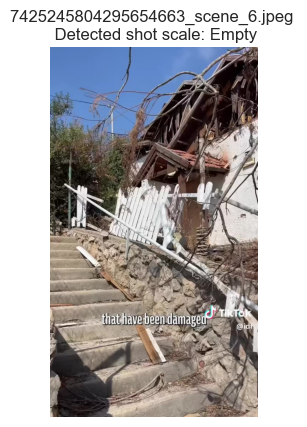

Scene: 7425245804295654663.mp4_scene_6 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


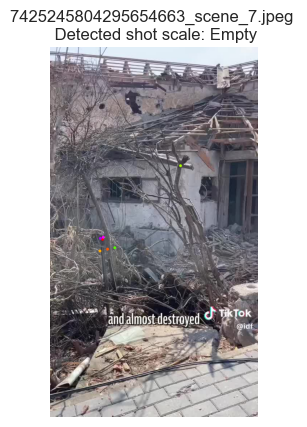

Scene: 7425245804295654663.mp4_scene_7 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


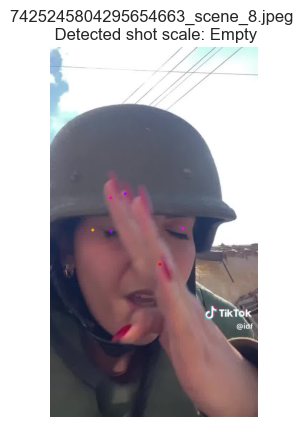

Scene: 7425245804295654663.mp4_scene_8 - Original: Medium close up - Classified: Empty
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


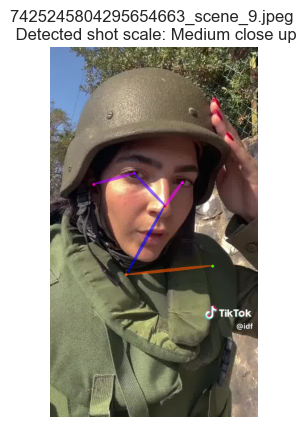

Scene: 7425245804295654663.mp4_scene_9 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


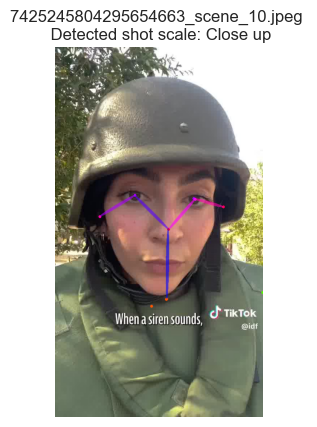

Scene: 7425245804295654663.mp4_scene_10 - Original: Medium close up - Classified: Close up
No match

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


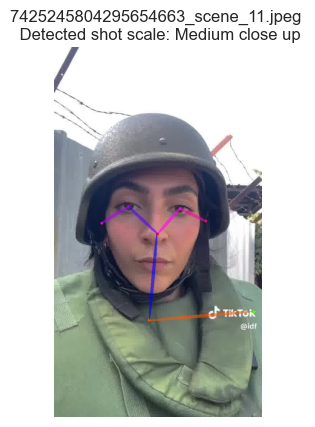

Scene: 7425245804295654663.mp4_scene_11 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


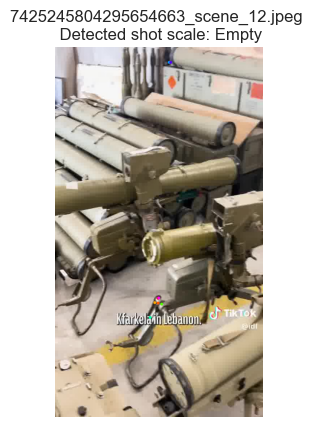

Scene: 7425245804295654663.mp4_scene_12 - Original: Empty - Classified: Empty

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


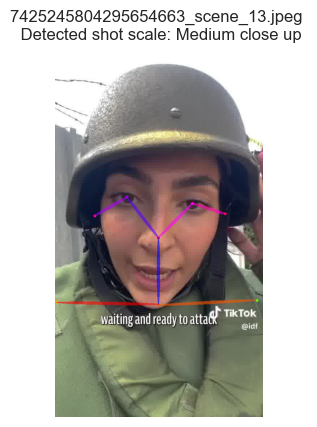

Scene: 7425245804295654663.mp4_scene_13 - Original: Medium close up - Classified: Medium close up

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


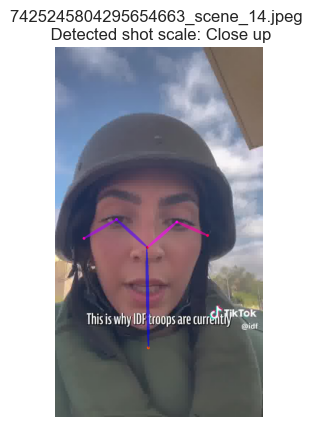

Scene: 7425245804295654663.mp4_scene_14 - Original: Medium close up - Classified: Close up
No match



In [ ]:
# Loop through scene dataframe and apply shot scale classification
%matplotlib inline

for index, scene in df_scene_test.iterrows():
    video_id = scene['url']
    scene_id = scene['id']

    cleaned_id = re.sub(r'\.mp4', '', scene_id)
    image_path = os.path.join(frames_folder, str(video_id), f'{cleaned_id}.jpeg')
    # Add manually coded labels for validation
    coded_shot_scale = scene['shot_scale_m']
    shot_scale = get_shot_scale(image_path)
    plt.savefig(f'/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/shot_scale_results/{cleaned_id}.svg')
    plt.show()

    # Tuning prints if needed to show the original labels
    print(f'Scene: {scene_id} - Original: {coded_shot_scale} - Classified: {shot_scale}')
    if coded_shot_scale != shot_scale:
        print('No match')
    print()

    df_scene_test.at[index, 'shot_scale_classifier'] = shot_scale

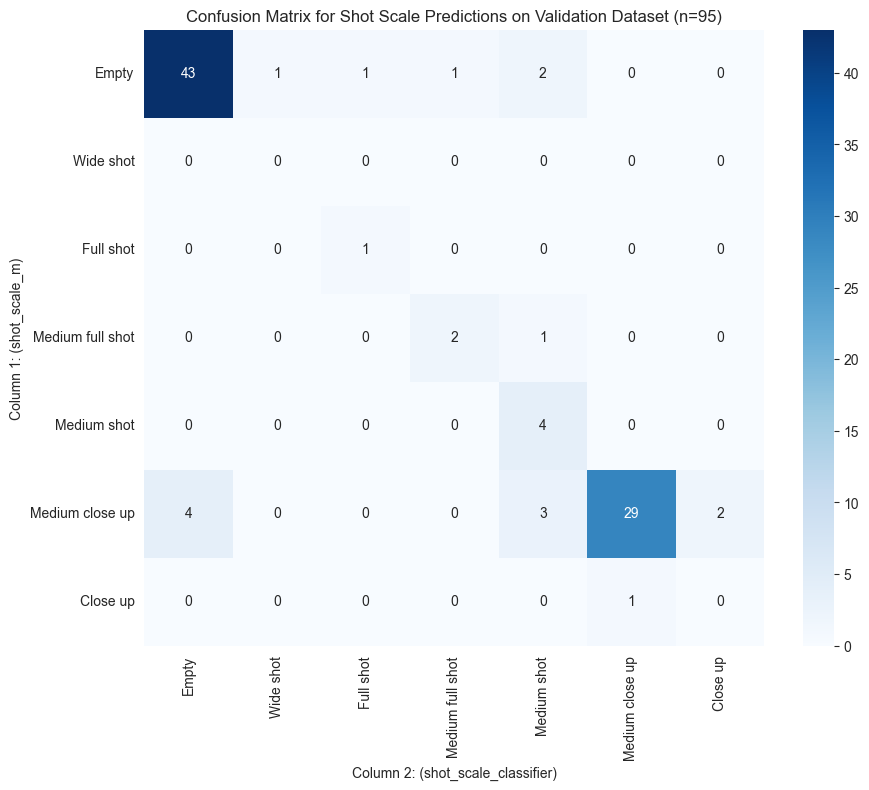

In [ ]:
# Generate the confusion matrix
plot_confusion_matrix(df_scene_test,
                      'shot_scale_m',
                      'shot_scale_classifier',
                      ['Empty',
                       'Wide shot',
                       'Full shot',
                       'Medium full shot',
                       'Medium shot', 'Medium close up', 'Close up'],
                      title = "Confusion Matrix for Shot Scale Predictions on Validation Dataset (n=95)")

plt.savefig('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/cm_valid.svg')
plt.show()

In [ ]:
calc_k_alpha_shot_scale_ord(df_scene_test,['shot_scale_m','shot_scale_classifier'])
calc_k_alpha_shot_scale_ord(df_scene_test,['shot_scale_m','shot_scale_c'])


Number of rows with NaN values/'Uncertain' (excluded from calculation): 0
Krippendorff’s alpha (ordinal) for ['shot_scale_m', 'shot_scale_classifier']: 0.854
Number of rows with NaN values/'Uncertain' (excluded from calculation): 0
Krippendorff’s alpha (ordinal) for ['shot_scale_m', 'shot_scale_c']: 0.926


(0.9257265604325912, 0)

In [ ]:
f1 = f1_score(df_scene_test['shot_scale_m'], df_scene_test['shot_scale_classifier'], average='weighted')
f1

0.8507029182864281

In [ ]:
print(classification_report(df_scene_test['shot_scale_m'], df_scene_test['shot_scale_classifier']))


                  precision    recall  f1-score   support

        Close up       0.00      0.00      0.00         1
           Empty       0.91      0.90      0.91        48
       Full shot       0.50      1.00      0.67         1
 Medium close up       0.97      0.76      0.85        38
Medium full shot       0.67      0.67      0.67         3
     Medium shot       0.40      1.00      0.57         4
       Wide shot       0.00      0.00      0.00         0

        accuracy                           0.83        95
       macro avg       0.49      0.62      0.52        95
    weighted avg       0.89      0.83      0.85        95



/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1705: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `

The F1 score appears to be better on the test dataset. Medium close up continues to have many false negatives due to the lack of a proper chest keypoint. Nonetheless, this provides a good basis for shot scale classification of the main dataset.

It is also apparent that the model can get confused by multiple people in the frame, as well as 'ghost figures' from silhouette shapes made out of objects. The algorithm is also biased towards taking the largest figure in the image when dealing with situations which may skew the classification.